<a href="https://colab.research.google.com/github/ulkuhos/Sayisal_Goruntu_Isleme_2024/blob/main/Ulku_DIP_Final_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **FİNAL**

**Not**: Gökalp hocam, verdiğiniz bu proje dosyası üzerinde çalışarak çalışmalarımı word dokumanına aktardım ve final için istediğiniz yönergelere uygun şekilde gerçekleştirdim.

## VERI YUKLEME

Bu dersin arasınavında , [ChestX-ray8 dataset](https://arxiv.org/abs/1705.02315) veri seti'nden alınan göğüs röntgeni görüntüleriyle çalışıyoruz.
<img src="https://raw.githubusercontent.com/hardik0/AI-for-Medicine-Specialization/master/AI-for-Medical-Diagnosis/Week-1/xray-image.png" alt="U-net Image" width="300" align="middle"/>



# **1-Kütüphanelerin içe aktarılması:**

o	Veri işleme için pandas, sayısal işlemler için numpy, opencv ve skimage görselleştirme için matplotlib ve seaborn kütüphanelerini içe aktarın.

o	Ayrıca os modülünü kullanarak dosya yolunu belirtin.


In [119]:
# Gerekli kütüphaneleri içe aktarma:
import os  # Dosya yönetimi için
import numpy as np  # Sayısal işlemler için
import pandas as pd  # Veri işleme için
import cv2  # Görüntü işleme için OpenCV
import matplotlib.pyplot as plt  # Görselleştirme için Matplotlib
import seaborn as sns  # Veri görselleştirme için Seaborn
from skimage import io, color, filters  # skimage modülü ile görüntü işleme


Veri Setinin Yüklenmesi

o	train_df olarak adlandırılan veri çerçevesine CSV dosyasını yükleyin ve ilk birkaç satırı inceleme.

o	Toplam satır ve sütun sayısını ekrana yazdırma.


In [120]:
!git clone https://github.com/hardik0/AI-for-Medicine-Specialization
%cd AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/

Cloning into 'AI-for-Medicine-Specialization'...
remote: Enumerating objects: 1601, done.
remote: Counting objects: 100% (28/28), done.
remote: Compressing objects: 100% (28/28), done.
remote: Total 1601 (delta 9), reused 2 (delta 0), pack-reused 1573 (from 1)
Receiving objects: 100% (1601/1601), 720.36 MiB | 23.77 MiB/s, done.
Resolving deltas: 100% (30/30), done.
Updating files: 100% (1497/1497), done.
/content/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis


In [121]:
%ls nih/

densenet.hdf5  images_small/  pretrained_model.h5  test.csv  train-small.csv  valid-small.csv


o	Toplam satır ve sütun sayısını ekrana yazdırma.

In [122]:
# Eğitim verilerini içeren CSV dosyasını okuma:
train_df = pd.read_csv("nih/train-small.csv")
# İlk 5 satırı yazdırma:
print(f'There are {train_df.shape[0]} rows and {train_df.shape[1]} columns in this data frame')
train_df.head()

There are 1000 rows and 16 columns in this data frame


,Image,Atelectasis,Cardiomegaly,Consolidation,Edema,Effusion,Emphysema,Fibrosis,Hernia,Infiltration,Mass,Nodule,PatientId,Pleural_Thickening,Pneumonia,Pneumothorax
0,00008270_015.png,0,0,0,0,0,0,0,0,0,0,0,8270,0,0,0
1,00029855_001.png,1,0,0,0,1,0,0,0,1,0,0,29855,0,0,0
2,00001297_000.png,0,0,0,0,0,0,0,0,0,0,0,1297,1,0,0
3,00012359_002.png,0,0,0,0,0,0,0,0,0,0,0,12359,0,0,0
4,00017951_001.png,0,0,0,0,0,0,0,0,1,0,0,17951,0,0,0


Have a look at the various columns in this csv file. The file contains the names of chest x-ray images ("Image" column) and the columns filled with ones and zeros identify which diagnoses were given based on each x-ray image.

### Data types and null values check
Run the next cell to explore the data types present in each column and whether any null values exist in the data.

### Explore data labels
Run the next two code cells to create a list of the names of each patient condition or disease.

In [124]:
columns = train_df.keys()
columns = list(columns)
print(columns)

['Image', 'Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'Nodule', 'PatientId', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']


In [125]:
# Gereksiz öğeleri kaldırma:
columns.remove('Image')
columns.remove('PatientId')
# Sınıfların toplamını alma:
print(f"There are {len(columns)} columns of labels for these conditions: {columns}")

There are 14 columns of labels for these conditions: ['Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'Nodule', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']


#**2. Görüntü Yükleme ve Görselleştirme**
1-Rastgele Görüntüler Seçme

o	train_df içindeki "Image" sütunundan rastgele 9 görüntü seçme.

o	Bu görüntüleri yan yana görselleştirerek veri setindeki örnek görüntüleri inceleme.


Rastgele Görüntüleri Göster


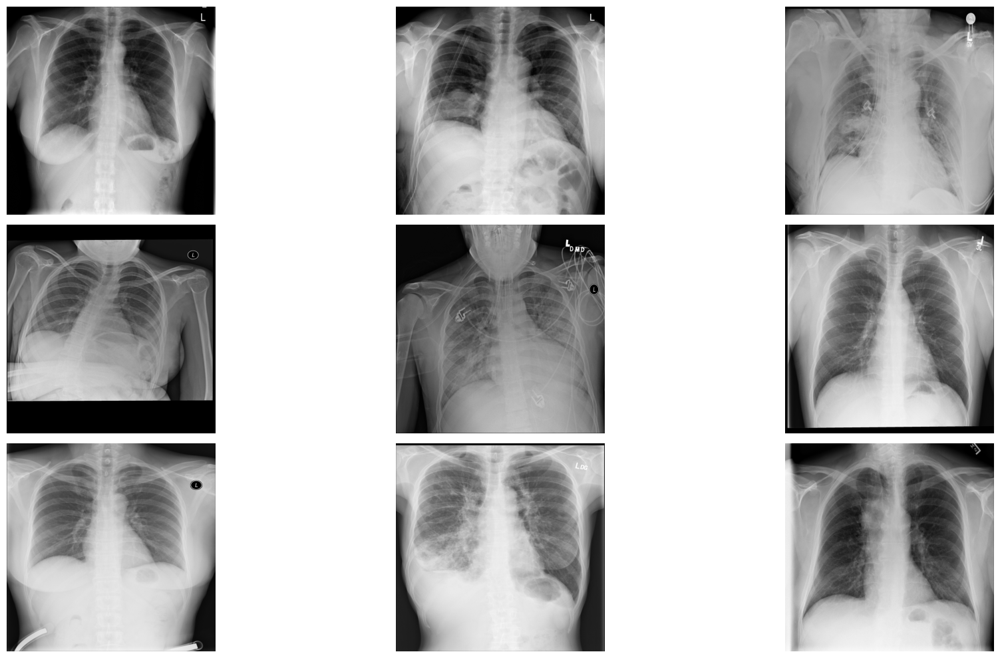

In [126]:
# Veri çerçevesindeki "Image" sütunundan numpy değerlerini çıkarma:
images = train_df['Image'].values

# İçinden rastgele 9 görüntü seçme:
random_images = [np.random.choice(images) for i in range(9)]

# Görüntülerin bulunduğu dizin konumu:
img_dir = 'nih/images_small/'

print('Rastgele Görüntüleri Göster')

# Görüntü boyutunu ayarlama:
plt.figure(figsize=(20,10))

# Seçilen rastgele görüntüleri görselleştirme:
for i in range(9):
    plt.subplot(3, 3, i + 1)
    img = plt.imread(os.path.join(img_dir, random_images[i]))
    plt.imshow(img, cmap='gray')
    plt.axis('off')

# Alt grafiklerin konumlandırmasını düzenleyerek uygun boşluk bırakma:
plt.tight_layout()

**BEN RASTGELE GELEN GÖRÜNTÜLERİN, GÖRÜNTÜ NUMARALARINI ALDIM VE EKRANA İLK HALLERİNİ YAZDIRIYORUM:**

Display Original Images


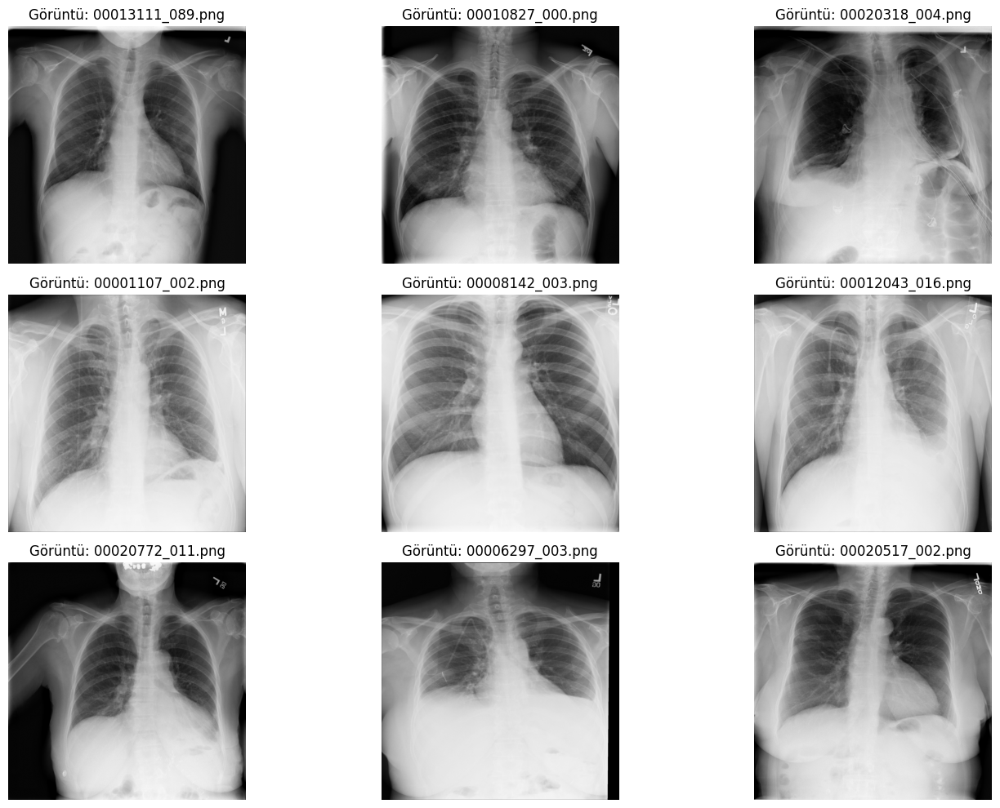

In [127]:
from skimage.io import imread

# Görüntülerin bulunduğu klasörün yolu:
img_dir = 'nih/images_small/'  # Görüntülerin olduğu dizin

# Görüntü dosya adları:
image_list = [
    "00013111_089.png",
    "00010827_000.png",
    "00020318_004.png",
    "00001107_002.png",
    "00008142_003.png",
    "00012043_016.png",
    "00020772_011.png",
    "00006297_003.png",
    "00020517_002.png"
]

# Görüntüleri ekrana basma:
print('Display Original Images')

# Görüntülerinizin boyutunu ayarlama:
plt.figure(figsize=(15, 10))

# Orijinal görüntüleri döngü ile görselleştirme:
for i in range(9):
    plt.subplot(3, 3, i + 1)
    img = imread(os.path.join(img_dir, image_list[i]))
    plt.imshow(img, cmap='gray')
    plt.axis('off')
    plt.title(f"Görüntü: {image_list[i]}")

# Alt grafiklerin konumlandırmasını düzenleyerek uygun boşluk bırakma:
plt.tight_layout()
plt.show()

2-Rastgele Görüntülerin İstatistiksel Özelliklerini Hesaplama

o	Seçilen görüntülerin her biri için maksimum, minimum, ortalama ve standart sapma değerlerini hesaplama:


### **RASTGELE SECİLMİŞ 9 GÖRÜNTÜNÜN ISTATISTIKSEL ÖZELLİKLERİNİ (MAKSIMUM, MINIMUM, MEAN VE STD) HESAPLAYIN. ORNEK OLARAK BIR GORUNTU ICIN HESAPLAMA YAPILMISTIR.**

The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 0.9804 and the minimum is 0.0000
The mean value of the pixels is 0.4796 and the standard deviation is 0.2757


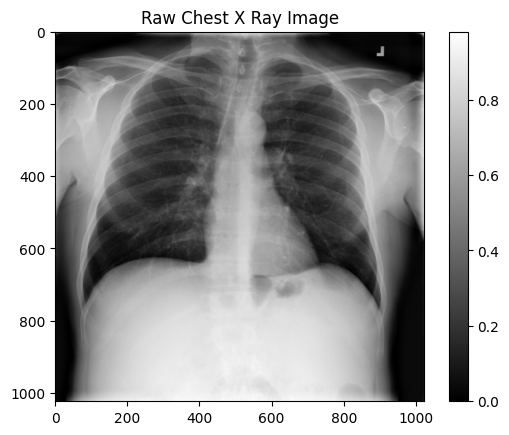

In [128]:
sample_img = train_df.Image[0]
raw_image = plt.imread(os.path.join(img_dir, sample_img))
plt.imshow(raw_image, cmap='gray')
plt.colorbar()
plt.title('Raw Chest X Ray Image')
print(f"The dimensions of the image are {raw_image.shape[0]} pixels width and {raw_image.shape[1]} pixels height, one single color channel")
print(f"The maximum pixel value is {raw_image.max():.4f} and the minimum is {raw_image.min():.4f}")
print(f"The mean value of the pixels is {raw_image.mean():.4f} and the standard deviation is {raw_image.std():.4f}")

### **CEVAP:  AŞAĞIDA; RASTGELE SECİLMİŞ 9 GÖRÜNTÜNÜN ISTATISTIKSEL ÖZELLİKLERİNİ (MAKSIMUM, MINIMUM, MEAN VE STD) HESAPLADIM.**

### **Bunları yukarıda rasgele gelen görüntülere uyguladım. Onları bir diziye atadım. Sonraki işlemlerde de kullandım.**


Image 1: 00013111_089.png
The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 255.0000
The minimum pixel value is 0.0000
The mean value of the pixels is 105.6965
The standard deviation of the pixels is 68.8102

Image 2: 00010827_000.png
The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 255.0000
The minimum pixel value is 0.0000
The mean value of the pixels is 108.5053
The standard deviation of the pixels is 65.2665

Image 3: 00020318_004.png
The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 248.0000
The minimum pixel value is 0.0000
The mean value of the pixels is 130.0811
The standard deviation of the pixels is 63.8455

Image 4: 00001107_002.png
The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel v

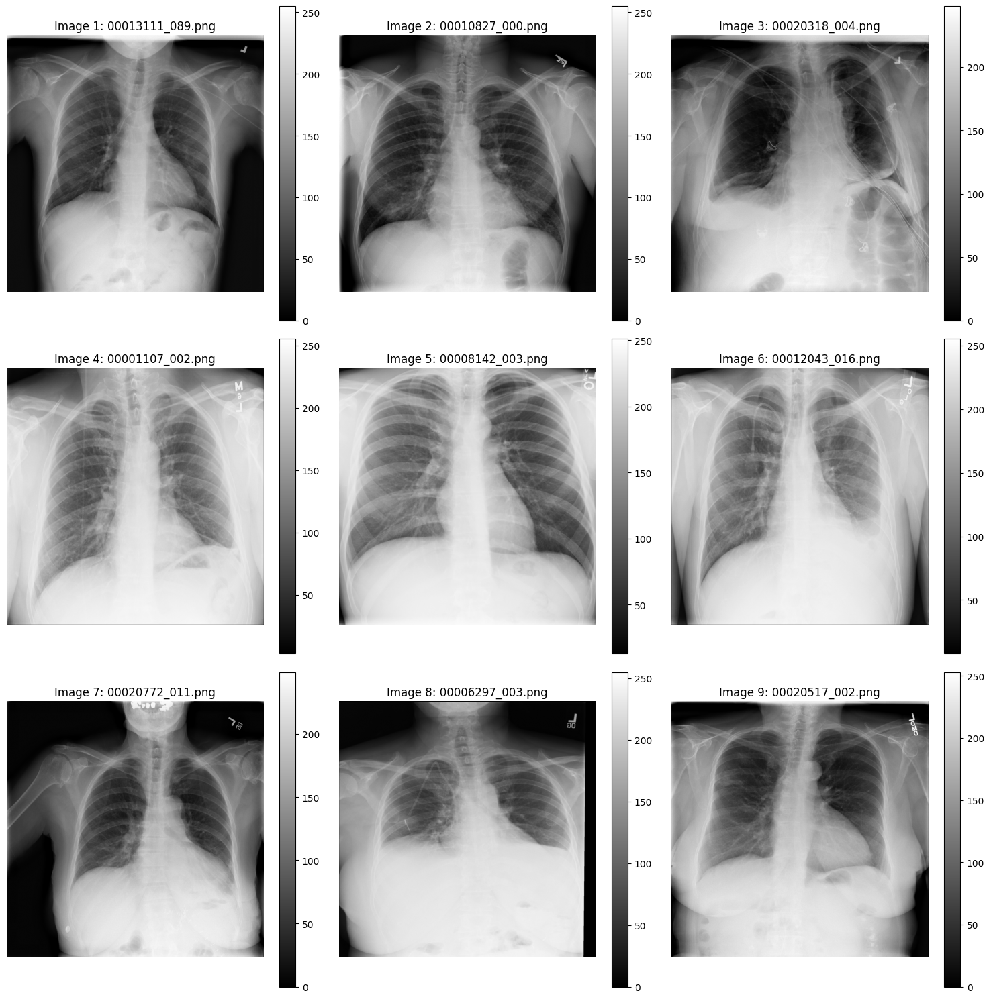

In [129]:
# Görüntülerin bulunduğu klasörün yolu:
img_dir = 'nih/images_small/'  # Görüntülerin olduğu dizin

# Seçtiğiniz 9 görüntü dosya adları:
image_list = [
    "00013111_089.png",
    "00010827_000.png",
    "00020318_004.png",
    "00001107_002.png",
    "00008142_003.png",
    "00012043_016.png",
    "00020772_011.png",
    "00006297_003.png",
    "00020517_002.png"
]

# 9 Görüntüyü işle ve görselleştirme:
plt.figure(figsize=(15, 15))  # Tüm görüntüleri göstermek için büyük bir figür boyutu
for i, img_name in enumerate(image_list):
    # Görüntünün yolunu oluştur
    img_path = os.path.join(img_dir, img_name)

    # Görüntüyü yükleme:
    raw_image = imread(img_path)

    # Görüntüyü görselleştir
    plt.subplot(3, 3, i + 1)  # 3x3 gridde görüntüleri yerleştir
    plt.imshow(raw_image, cmap='gray')
    plt.colorbar()
    plt.title(f'Image {i+1}: {img_name}')
    plt.axis('off')

    # İstatistiksel özellikleri hesaplama:
    max_val = raw_image.max()
    min_val = raw_image.min()
    mean_val = raw_image.mean()
    std_val = raw_image.std()

    # Sonuçları ekrana yazdırma:
    print(f"\nImage {i+1}: {img_name}")
    print(f"The dimensions of the image are {raw_image.shape[0]} pixels width and {raw_image.shape[1]} pixels height, one single color channel")
    print(f"The maximum pixel value is {max_val:.4f}")
    print(f"The minimum pixel value is {min_val:.4f}")
    print(f"The mean value of the pixels is {mean_val:.4f}")
    print(f"The standard deviation of the pixels is {std_val:.4f}")

plt.tight_layout()  # Görüntülerin çakışmasını önlemek için
plt.show()


# **3. Görüntü İşleme ve İyileştirme**

**1.**Görüntüleri Akciğer bölgeleri kaybolmayacak şekilde kenarlardan kırpın (Crop),(ilgi alanı dışındaki gürültü bölgelerinden kurtulun.

**o** Orijinal ve Crop edilmiş görüntüleri görseleştirin.

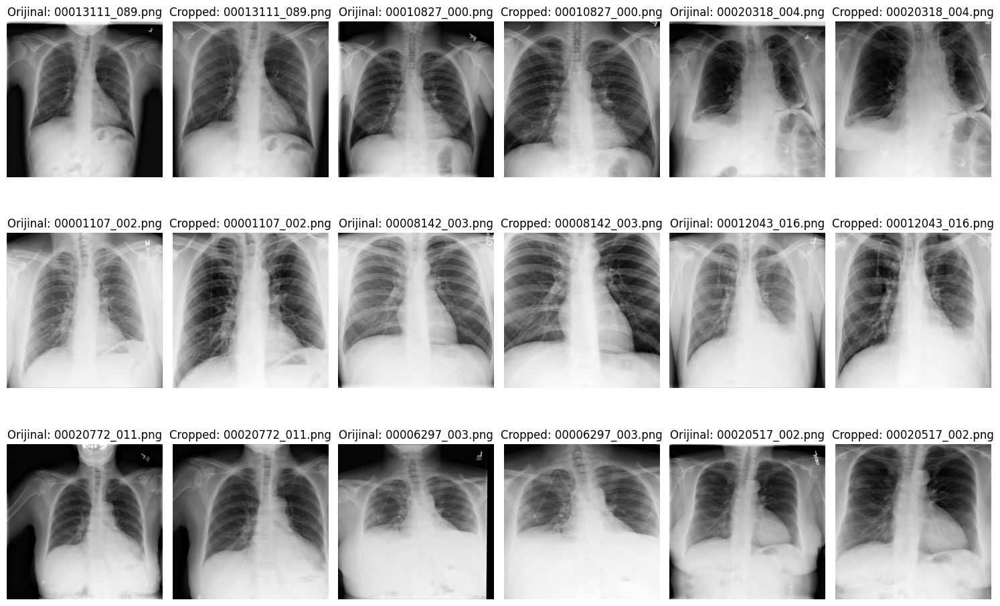

In [130]:
# Kırpma işlemi için belirlediğimiz sınırlar ( %10 kırpma yapıldı, bu değiştirilebilir):
crop_percent = 0.1  # Kenarlardan %10 kırpma işlemi

# Görüntüleri yükleyip kırpma işlemi yapma:
plt.figure(figsize=(15, 10))  # Görselleştirme için figür boyutu

for i, img_name in enumerate(image_list):
    # Görüntünün yolunu oluştur
    img_path = os.path.join(img_dir, img_name)

    # Görüntüyü yükleme (grayscale olduğu için doğrudan işleme uygun):
    raw_image = imread(img_path)

    # Görüntünün boyutlarını alma:
    h, w = raw_image.shape

    # Kırpma sınırlarını hesaplama: (kenarlardan %10 kırpma)
    x_start = int(w * crop_percent)
    x_end = int(w * (1 - crop_percent))
    y_start = int(h * crop_percent)
    y_end = int(h * (1 - crop_percent))

    # Görüntüyü kırpma:
    cropped_image = raw_image[y_start:y_end, x_start:x_end]

    # Orijinal ve kırpılmış görüntüleri yan yana gösterme:
    plt.subplot(3, 6, 2 * i + 1)  # Sol tarafa orijinal görüntü yer alıyor.
    plt.imshow(raw_image, cmap='gray')
    plt.title(f'Orijinal: {img_name}')
    plt.axis('off')

    plt.subplot(3, 6, 2 * i + 2)  # Sağ tarafa kırpılmış görüntü yer alıyor.
    plt.imshow(cropped_image, cmap='gray')
    plt.title(f'Cropped: {img_name}')
    plt.axis('off')

plt.tight_layout()
plt.show()


Üstteki görsellerden göreceğimiz üzere Orijinal görüntülerin genişliğinin ve yüksekliğinin %10'unu kenarlardan manuel olarak kırptım.

Orijinal ve kırpılmış görüntüleri yan yana görselleştirdim.

**2.**Arasınav ödevi çıktılarını inceleyerek Kontrast Germe (Stretching) Histogram Eşitleme (Equalization) yöntemlerinden uygun gördüğünüzü crop edilmiş görüntüye uygulayın. (YORUM)

**o** Crop edilmiş ve dönüşüme uğramış  görüntüleri görseleştirin.

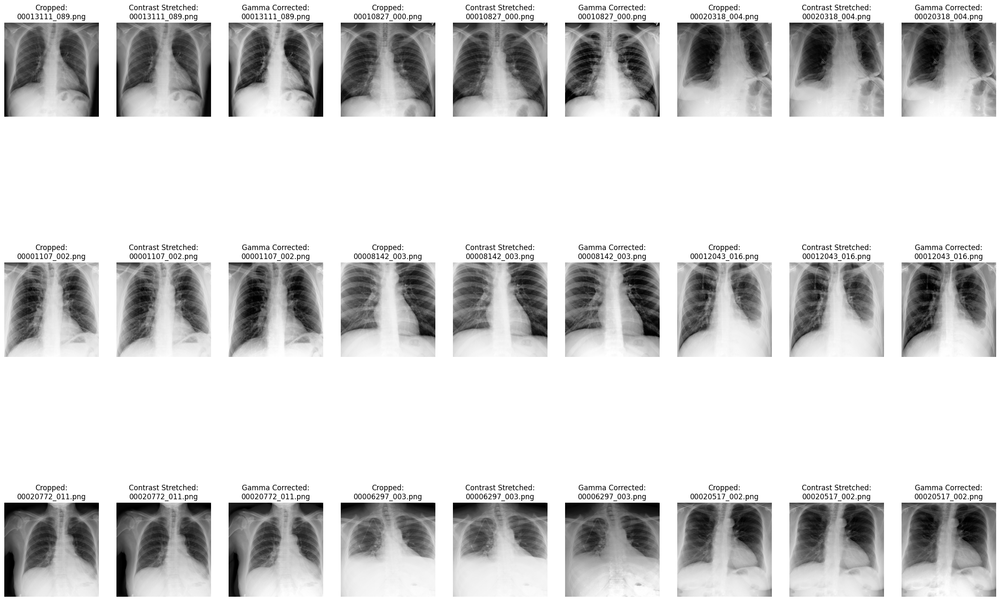

In [131]:
# Kontrast Germe Fonksiyonunu Kullanma:
def contrast_stretching(image):
    min_val = np.min(image)
    max_val = np.max(image)
    stretched = (image - min_val) / (max_val - min_val) * 255  # Normalize edip 0-255 aralığına getirme
    return stretched.astype(np.uint8)

# Histogram Eşitleme Fonksiyonunu  Kullanma:
def histogram_equalization(image):
    return cv2.equalizeHist(image)  # OpenCV Histogram Eşitleme

# Gamma Düzeltme Fonksiyonunu  Kullanma:
def gamma_correction(image, gamma=1.2):
    inv_gamma = 1.0 / gamma
    table = np.array([(i / 255.0) ** inv_gamma * 255 for i in np.arange(0, 256)]).astype("uint8")
    return cv2.LUT(image, table)

# Görüntüleri yükleyip işleme ve görselleştirme:
plt.figure(figsize=(24, 24))

for i, img_name in enumerate(image_list):
    img_path = os.path.join(img_dir, img_name)

    # Orijinal görüntüyü yükleme:
    raw_image = imread(img_path)

    # Crop işlemi:
    h, w = raw_image.shape
    crop_percent = 0.1
    x_start, x_end = int(w * crop_percent), int(w * (1 - crop_percent))
    y_start, y_end = int(h * crop_percent), int(h * (1 - crop_percent))
    cropped_image = raw_image[y_start:y_end, x_start:x_end]

    # Kontrast Germe Uygulama:
    contrast_stretched = contrast_stretching(cropped_image)

    # Histogram Eşitleme Uygulama:
    hist_equalized = histogram_equalization(contrast_stretched)

    # Gamma Düzeltme Uygulama:
    gamma_corrected = gamma_correction(hist_equalized, gamma=1.2)

    # Görselleştirme:
    plt.subplot(4, 9, 3 * i + 1)
    plt.imshow(cropped_image, cmap='gray')
    plt.title(f'Cropped:\n{img_name}', fontsize=12)
    plt.axis('off')

    plt.subplot(4, 9, 3 * i + 2)
    plt.imshow(contrast_stretched, cmap='gray')
    plt.title(f'Contrast Stretched:\n{img_name}', fontsize=12)
    plt.axis('off')

    plt.subplot(4, 9, 3 * i + 3)
    plt.imshow(gamma_corrected, cmap='gray')
    plt.title(f'Gamma Corrected:\n{img_name}', fontsize=12)
    plt.axis('off')

plt.tight_layout(pad=3)  # Boşlukları ayarlama işlemi.
plt.show()


Görsellerin özellikle akciğer içindeki detayları daha net hale getirmesi gerekiyor.

**Kullandığım yöntemleri inceleyince şu sonuçları gözlemledim:**

-Kontrast germe, görüntülerde belirginliği artırdı ama bazı koyu alanları yeterince vurgulamadı.

-Ardından Histogram Eşitleme kullandım. Histogram Eşitleme işlemi genel olarak kontrastı artırdı, koyu ve açık bölgeler arasındaki fark netleşti, parlaklık daha dengeli hale geldi. Ama bazı görüntüler hala aşırı parlak görünüyor. Görsellerde gördüğümüz üzere bazı röntgenler aşırı beyaz kalmış. Bu nedenle Gamma Düzeltme (Gamma Correction) uygulamak daha uygun olacağını düşündüm ve yaptığım denemelerden özellikle çok parlak veya çok karanlık olan bölgeleri daha doğal hale getirmek için Gamma Düzeltme kullanmanın daha verimli olduğunu gördüm.

**Görüntüler üstteki görsellerde olduğu gibidir:**

1-Cropped (Kırpılmış) Görüntüler:

Ham görüntüler, yani herhangi bir işleme tabi tutulmamış halleridir.
Sorun: Kontrast düşük, bazı bölgeler çok parlak veya çok koyu.

2-Contrast Stretched (Kontrast Gerilmiş) Görüntüler:

Kontrast artırılmış, koyu ve açık alanlar daha belirgin hale gelmiş.
Avantaj: Görüntülerde detaylar biraz daha net hale gelmiş.
Dezavantaj: Bazı görüntülerde hala parlak alanlar fazla yayılmış olabilir.

3-Gamma Corrected (Gamma Düzeltmeli) Görüntüler:

Parlak alanlar daha iyi dengelenmiş, koyu alanlar daha görünür hale gelmiş.
Avantaj: Daha doğal bir kontrast sunuyor, hem koyu hem açık bölgeleri dengeleyerek en iyi görünürlüğü sağlıyor.
Dezavantaj: Bazı aşırı karanlık görüntülerde çok fazla detay eklenmemiş olabilir.

--
**Sonuç olarak:** Kırpılmış akciğer röntgenleri üzerinde yaptığım bu çeşitli iyileştirme işlemleri sonucunda, en uygun yöntemin Gamma Düzeltme (Gamma Correction) olduğunu belirledim. Bu yöntem, parlak ve koyu alanlar arasındaki dengesizliği en iyi şekilde gidererek daha doğal bir kontrast sağladı.



**3.**Bir önceki adımın çıktısına gürültü azaltma işlemlerinden birini seçerek uygulayın (örn: Median ve Gaussian Blur).

**o** Görüntüleri görseleştirin

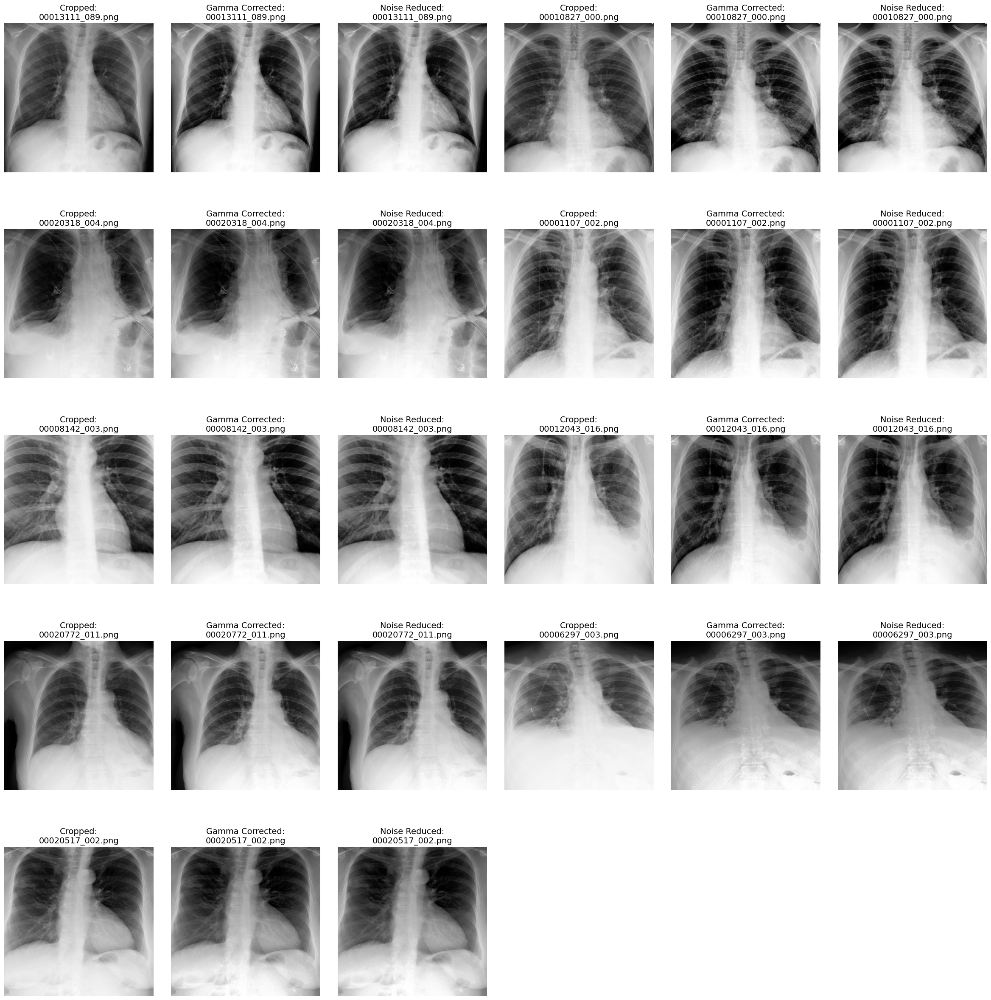

In [132]:
# Histogram Eşitleme Fonksiyonu:
def histogram_equalization(image):
    return cv2.equalizeHist(image)  # OpenCV Histogram Eşitleme

# Gamma Düzeltme Fonksiyonu (Güncellenmiş Gamma = 1.1):
def gamma_correction(image, gamma=1.1):  # GAMMA 1.1
    inv_gamma = 1.0 / gamma
    table = np.array([(i / 255.0) ** inv_gamma * 255 for i in np.arange(0, 256)]).astype("uint8")
    return cv2.LUT(image, table)

# Median Blur (Gürültü Azaltma) Fonksiyonu (Güncellenmiş Kernel = 3):
def median_blur(image, kernel_size=3):  # KERNEL BOYUTU 3
    return cv2.medianBlur(image, kernel_size)

# Görüntüleri yükleyip işleme ve görselleştirme:
num_images = len(image_list)
cols = 6  # En fazla 6 sütun olacak
rows = (num_images * 3 + cols - 1) // cols  # Satır sayısını belirleme (her görüntü için 3 işlem yapılıyor)

plt.figure(figsize=(24, rows * 5))

for i, img_name in enumerate(image_list):
    img_path = os.path.join(img_dir, img_name)

    # Orijinal görüntüyü yükleme:
    raw_image = imread(img_path)

    # Crop işlemi (Kenarlardaki siyah çerçeveyi tamamen kaldırmak için oran arttırma):
    h, w = raw_image.shape
    crop_percent = 0.12  # KIRPMA ORANI 0.12
    x_start, x_end = int(w * crop_percent), int(w * (1 - crop_percent))
    y_start, y_end = int(h * crop_percent), int(h * (1 - crop_percent))
    cropped_image = raw_image[y_start:y_end, x_start:x_end]

    # Histogram Eşitleme Uygulama:
    hist_equalized = histogram_equalization(cropped_image)

    # Gamma Düzeltme Uygula (Gamma = 1.1)
    gamma_corrected = gamma_correction(hist_equalized, gamma=1.1)

    # Median Blur (Gürültü Azaltma) Uygula (Kernel = 3)
    noise_reduced = median_blur(gamma_corrected, kernel_size=3)

    # Görselleştirme (Yan Yana 6 Görüntüye kadar)
    plt.subplot(rows, cols, i * 3 + 1)
    plt.imshow(cropped_image, cmap='gray')
    plt.title(f'Cropped:\n{img_name}', fontsize=14)
    plt.axis('off')

    plt.subplot(rows, cols, i * 3 + 2)
    plt.imshow(gamma_corrected, cmap='gray')
    plt.title(f'Gamma Corrected:\n{img_name}', fontsize=14)
    plt.axis('off')

    plt.subplot(rows, cols, i * 3 + 3)
    plt.imshow(noise_reduced, cmap='gray')
    plt.title(f'Noise Reduced:\n{img_name}', fontsize=14)
    plt.axis('off')

plt.tight_layout(pad=3)  # Boşlukları optimize etme:
plt.show()


**İlk sütun:** Crop edilen görüntüler (Orijinal hali)

**İkinci sütun:** Gamma Correction uygulanan görüntüler

**Üçüncü sütun:** Gürültü azaltılmış görüntüler (Median Blur sonrası)

Median Blur seçtim çünkü; Tıbbi görüntülerde detayları koruyarak gürültüyü azaltmak için daha uygunbir yöntem. Özellikle tuz-biber gürültüsüne karşı etkili, pürüzsüz hale getimektedir. Ve son olarak Gaussian Blur'a göre daha iyi kenar koruması sağladığını gözlemledim.

**Yaptığımız işlemler ve sonuçarı genel olarak şu şekildedir:**

-Tüm görüntülerde kontrast iyileştirildi, kenar boşlukları temizlendi ve gürültü azaltıldı.

-Gamma düzeltme (1.1) ile parlaklığı dengeledik ve gereksiz aşırı aydınlatmayı bu şekilde önledik.

-Noise Reduction (Kernel = 3) ile detaylar korunarak gürültü azaltma işlemi yapılmıştır.


**00013111_089.png:** Net ve kontrastı iyileştirilmiş bir görüntü elde edildi. Daha fazla detay korunması için gamma değerini daha da düşürebiliriz.

**00010827_000.png:** Siyah kenarlar tamamen kaldırılırsa daha iyi olabilir, ancak görüntü genel olarak iyileştirildi.

**00020318_004.png:** İyi bir iyileştirme sağlanmış olup, tıbbi analiz için uygun hale getirildi.

**00001107_002.png:** Genel olarak net bir görüntü elde edildi, ancak parlaklığı biraz daha azaltabiliriz.

**00008142_003.png:** Başarılı bir işlem oldu. Ek bir iyileştirme gerekmiyor.

**00012043_016.png:** Yeterince net ve dengeli bir görüntü elde edildi.

**00020772_011.png:** Genel olarak tıbbi analiz için uygun bir görüntü elde edildi.

**00006297_003.png:** Genel olarak iyileştirme başarılı görünüyor ancak gürültü azaltma yöntemi değiştirilerek yeniden test edilebilir.

**00020517_002.png:** Netlik ve kontrast açısından uygun hale
getirilmiş, ek bir iyileştirmeye gerek yok.


**4.**Eşik sayısı belirleme

**o** Tek eşik değeri kullanacaksanız, Görüntülere Gauss yoğunluk dönüşümü gibi akciğer yoğunluk değerleri ile düşük ve yüksek değerleri ayıracak bir transform uygulayınız.

**o** Dönüşüm uygulanmayacaksa optimum eşik sayısı belirlenmeli bunu dikkate alın. (örnek1: eşik sayısı 2 bölge sayısı 3 (alt-orta-üst)  orta=1, else=0, örnek2:esik sayısı 5, bölge sayısı 6 (a1-a2-o1-o2-u1-u2) o1&o2=1, else=0)


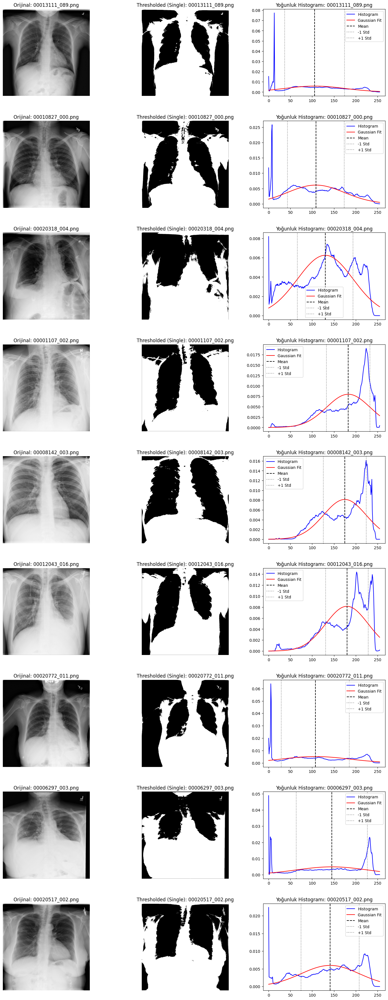

In [133]:
from scipy.stats import norm

# Görüntülerin bulunduğu dizin:
img_dir = 'nih/images_small/'

# Yoğunluk bölgelerini belirlemek için kullandığımız fonksiyon:
def gaussian_thresholding(image, threshold_type='single'):
    """
    Gaussian yoğunluk dönüşümü kullanarak dinamik eşikleme uygularız.
    threshold_type: 'single' (tek eşik) veya 'multi' (çoklu eşik) olabilir.
    """
    # Histogram hesaplama:
    hist_values, bin_edges = np.histogram(image.flatten(), bins=256, range=[0, 256], density=True)

    # Histogramdan ortalama ve standart sapma hesaplama:
    mean_intensity = np.mean(image)
    std_intensity = np.std(image)

    # Gauss dağılımını oluşturma:
    x = np.linspace(0, 255, 256)
    gauss_curve = norm.pdf(x, mean_intensity, std_intensity)

    # Tek eşikleme (ortalama değere göre bölme) kısmı:
    if threshold_type == 'single':
        _, thresholded = cv2.threshold(image, mean_intensity, 255, cv2.THRESH_BINARY)

    # Çoklu eşikleme (alt-orta-üst yoğunluk bölgeleri) kısmı:
    elif threshold_type == 'multi':
        low_thresh = mean_intensity - std_intensity
        high_thresh = mean_intensity + std_intensity
        thresholded = np.zeros_like(image)
        thresholded[(image >= low_thresh) & (image <= high_thresh)] = 1  # Orta bölge
        thresholded[(image < low_thresh) | (image > high_thresh)] = 0  # Düşük ve yüksek bölgeler

    return thresholded, mean_intensity, std_intensity, hist_values, gauss_curve

# Görüntüleri yükleyip işleme ve görselleştirme:
num_images = len(image_list)
cols = 3  # Yan yana gösterilecek görüntü sayısını belirledik.
rows = num_images

plt.figure(figsize=(15, rows * 4))

for i, img_name in enumerate(image_list):
    img_path = os.path.join(img_dir, img_name)

    # Görüntüyü yükle ve gri tona çevirme kısmı:
    image = imread(img_path)

    # Gaussian Thresholding uygulama (tek eşik):
    thresholded, mean_intensity, std_intensity, hist_values, gauss_curve = gaussian_thresholding(image, threshold_type='single')

    # Görselleştirme kısmı:
    plt.subplot(rows, cols, i * cols + 1)
    plt.imshow(image, cmap='gray')
    plt.title(f'Orijinal: {img_name}', fontsize=12)
    plt.axis('off')

    plt.subplot(rows, cols, i * cols + 2)
    plt.imshow(thresholded, cmap='gray')
    plt.title(f'Thresholded (Single): {img_name}', fontsize=12)
    plt.axis('off')

    plt.subplot(rows, cols, i * cols + 3)
    plt.plot(np.linspace(0, 255, 256), hist_values, color='blue', label="Histogram")
    plt.plot(np.linspace(0, 255, 256), gauss_curve, color='red', label="Gaussian Fit")
    plt.axvline(mean_intensity, color='black', linestyle='--', label="Mean")
    plt.axvline(mean_intensity - std_intensity, color='gray', linestyle=':', label="-1 Std")
    plt.axvline(mean_intensity + std_intensity, color='gray', linestyle=':', label="+1 Std")
    plt.legend()
    plt.title(f'Yoğunluk Histogramı: {img_name}', fontsize=12)

plt.tight_layout(pad=3)
plt.show()


**Yukarıdaki Çıktıların Yorumu:**

Tek eşikleme (single thresholding) ile Gauss yoğunluk dönüşümünü kullandık.

Görüntünün histogramı çıkardım. Gaussian dağılımını modelleyerek ortalama yoğunluk değeri (mean_intensity) eşik olarak kullandım.
Görüntü, bu eşik değere göre yüksek ve düşük yoğunluklar şeklinde ikiye ayrıldı.
Eşikleme sonucunda akciğer yoğunluk bölgesi belirgin hale geldi ve düşük-yüksek yoğunluklar şeklinde ikiye ayrıldı. Gaussian eşikleme bazı görüntülerde iyi çalışıyor, ancak bazıları için multi-thresholding yöntemi uygulayıp sonuçlara bakabiliriz.

**00013111_089.png:** Histogram multimodal, Gaussian fit tam modelleyemiyor. Eşikleme başarılı ama daha hassas ayrım için multi-thresholding deneyebiliriz.

**0010827_000.png:** Histogram geniş ve yayılmış, Gaussian fit tam uyumlu değil.
Eşikleme genel olarak iyi ama kontrast çeşitliliği fazla görünüyor.

**00020318_004.png:** Histogram daha düzgün, Gaussian fit iyi görünüyor.
Gaussian modeli iyi çalışmış, akciğer bölgesi doğru ayrılmış.

**0001107_002.png:** Histogram çift tepe noktalı (bimodal), Gaussian fit tam modelleyememiş. Multi-thresholding yöntemi daha iyi olabilir.

**0008142_003.png:** Histogram geniş ve çok fazla kontrast farkı olduğunu görüyoruz. Gaussian fit bazı bölgeleri kaçırıyor, ek gürültü azaltma kullanabiliriz.

**00012043_016.png:**Histogram iki ana zirveye sahip ve Gaussian fit uyumsuz görünüyor. Multi-thresholding yöntemini kullanarak yeniden deneyebiliriz.

**00020772_011.png:**Histogram düzensiz ve Gaussian eğrisi iyi uyum sağlayamamış görünüyor. Adaptive thresholding veya farklı eşikleme yöntemleri kullanabiliriz.

**0006297_003.png:** Histogram geniş ama Gaussian fit oldukça uyumlu görünüyor.
Gaussian eşikleme iyi modellemiş, kontrast dengeli duruyor.

**00020517_002.png:** Histogram tek tepe noktası içeriyor, Gaussian fit çok iyi görünüyoe. Gaussian eşikleme burada başarılı, daha fazla işleme gerek olmadığını görüyoruz.


# **4.Thresholding**

1.	Global Thresholding, Otsu veya skimage all filter kütüphanesini kullanarak (from skimage.filters import try_all_threshold) https://scikit-image.org/docs/dev/auto_examples/segmentation/plot_thresholding.html en az 2 thresholding yöntemi  ile eşik değerlerini belirleyiniz.

2.	Eşik değerlerini görüntülere uygulayarak binary görüntüleri görselleştirip uygun thresholding yöntemini i seçiniz. (YORUM)


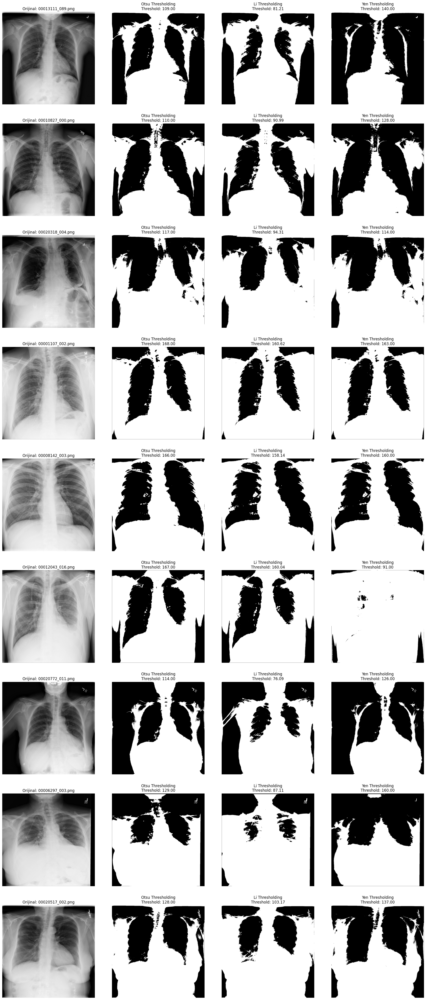

<Figure size 1000x800 with 0 Axes>

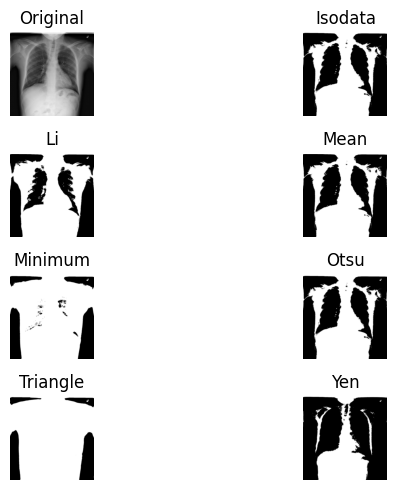

<Figure size 1000x800 with 0 Axes>

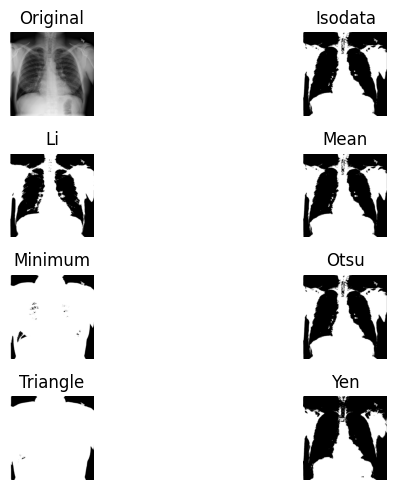

<Figure size 1000x800 with 0 Axes>

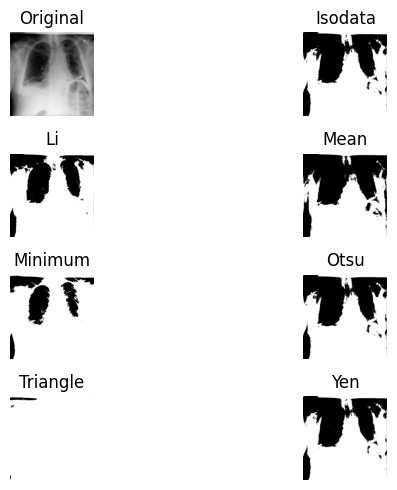

<Figure size 1000x800 with 0 Axes>

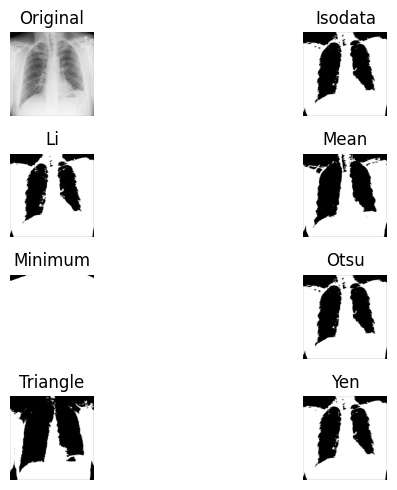

<Figure size 1000x800 with 0 Axes>

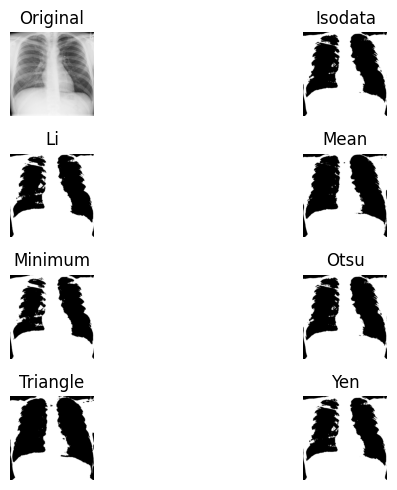

<Figure size 1000x800 with 0 Axes>

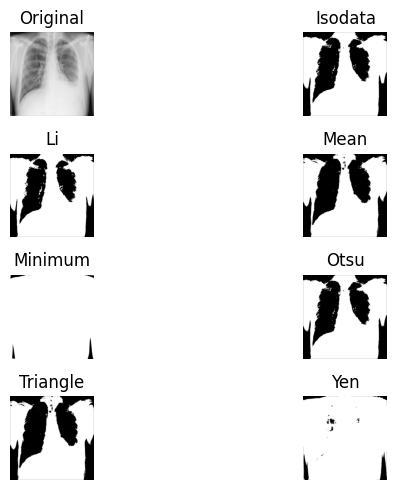

<Figure size 1000x800 with 0 Axes>

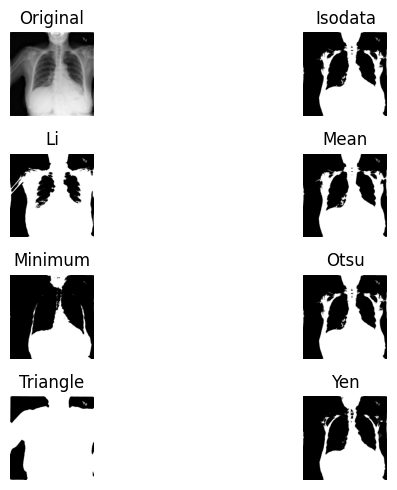

<Figure size 1000x800 with 0 Axes>

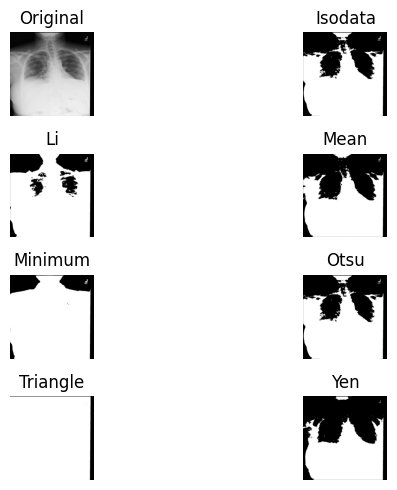

<Figure size 1000x800 with 0 Axes>

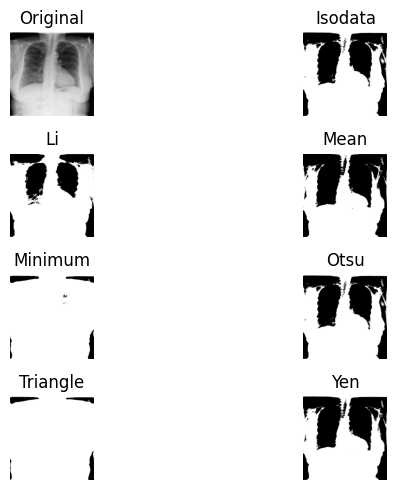

In [134]:
from skimage import filters
from skimage.filters import try_all_threshold, threshold_otsu, threshold_li, threshold_yen

# Görüntülerin bulunduğu dizin:
img_dir = 'nih/images_small/'

# Thresholding yöntemlerini test eden fonksiyon:
def apply_thresholding_methods(image):

    # Otsu yöntemi ile eşik belirleme:
    otsu_thresh = threshold_otsu(image)
    otsu_binary = image > otsu_thresh

    # Li yöntemi ile eşik belirleme:
    li_thresh = threshold_li(image)
    li_binary = image > li_thresh

    # Yen yöntemi ile eşik belirleme:
    yen_thresh = threshold_yen(image)
    yen_binary = image > yen_thresh

    return otsu_binary, otsu_thresh, li_binary, li_thresh, yen_binary, yen_thresh

# Görüntüleri yükleyip işleme ve görselleştirme:
num_images = len(image_list)
cols = 4  # Orijinal, Otsu, Li, Yen eşikleme için 4 sütun
rows = num_images

plt.figure(figsize=(20, rows * 5))

for i, img_name in enumerate(image_list):
    img_path = os.path.join(img_dir, img_name)

    # Görüntüyü yükle ve gri tona çevirme:
    image = imread(img_path)

    # Otsu, Li ve Yen thresholding uygulama:
    otsu_binary, otsu_thresh, li_binary, li_thresh, yen_binary, yen_thresh = apply_thresholding_methods(image)

    # Görselleştirme adımı:
    plt.subplot(rows, cols, i * cols + 1)
    plt.imshow(image, cmap='gray')
    plt.title(f'Orijinal: {img_name}', fontsize=12)
    plt.axis('off')

    plt.subplot(rows, cols, i * cols + 2)
    plt.imshow(otsu_binary, cmap='gray')
    plt.title(f'Otsu Thresholding\nThreshold: {otsu_thresh:.2f}', fontsize=12)
    plt.axis('off')

    plt.subplot(rows, cols, i * cols + 3)
    plt.imshow(li_binary, cmap='gray')
    plt.title(f'Li Thresholding\nThreshold: {li_thresh:.2f}', fontsize=12)
    plt.axis('off')

    plt.subplot(rows, cols, i * cols + 4)
    plt.imshow(yen_binary, cmap='gray')
    plt.title(f'Yen Thresholding\nThreshold: {yen_thresh:.2f}', fontsize=12)
    plt.axis('off')

plt.tight_layout(pad=3)
plt.show()

# try_all_threshold() ile tüm thresholding yöntemlerini gösterme:
for img_name in image_list:
    img_path = os.path.join(img_dir, img_name)
    image = imread(img_path)

    plt.figure(figsize=(10, 8))
    plt.suptitle(f'Tüm Thresholding Yöntemleri: {img_name}', fontsize=14)
    try_all_threshold(image, verbose=False)
    plt.show()


-Eşikleme (thresholding) yöntemlerini test edip görselleştirdim. Bunun için; Otsu, Li ve Yen yöntemlerini kullandım. Ek olarak diğer yöntemleri de (Isodata, Mean, Triangle, Minimum) inceledim.  En iyi yöntem seçilirken, hangi yöntemin akciğer bölgesini en iyi izole ettiğinin değerlendirilmesi gerekir.

-Eşikleme işlemi sonucunda elde edilen tüm görüntüler binary formattadır ve alnızca siyah ve beyaz renklerden oluşmaktadır. Uygulanan farklı thresholding yöntemleri, akciğer bölgesinin segmentasyonunda farklı sonuçlar ürettiğini yukarıdaki görüntülerden gözlemliyoruz.

**Görüntülere tek tek bakacak olursak şu sonuçları görüyoruz:**

**00013111_089.png:** Otsu: Akciğer sınırlarını oldukça iyi ayırdı, ancak bazı dış alanları da içeriyor. Li: Daha dengeli bir segmentasyon sağladı, ancak akciğer kenarlarında hafif bilgi kaybı var. Yen: Agresif eşikleme nedeniyle akciğer alanı daha fazla belirginleşti, ancak bazı detaylar kayboldu.
**Sonuç:** Li Thresholding en dengeli sonucu verdi.

**00010827_000.png:** Otsu: Akciğerlerin şekli net bir şekilde segmentlendi, ancak bazı ekstra bölgeler de dahil edildi. Li: Daha yumuşak bir segmentasyon sağladı, akciğer dokusunu iyi korudu. Yen: Fazla agresif eşikleme nedeniyle akciğer sınırlarını genişletmiş olabilir.**Sonuç:** Otsu yöntemi en iyi sonucu verdi.

**00020318_004.png:** Otsu: Akciğer bölgesini oldukça iyi çıkardı, ancak bazı küçük gürültüler mevcut. Li: Akciğerlerin iç yapısını en iyi koruyan yöntem oldu.Yen: Aşırı eşikleme nedeniyle bazı detayları kaybetti.**Sonuç:** Li yöntemi daha iyi bir segmentasyon sağladı.

**0001107_002.png:** Otsu: Genel hatları net bir şekilde belirledi, ancak göğüs bölgesinde fazla alan içerdi. Li: Dengeli bir segmentasyon sundu, ancak bazı gölge bölgeleri yanlış sınıflandırdı. Yen: Fazla agresif olduğu için detay kayıpları yaşandı.**Sonuç:** Otsu yöntemi en iyi sonucu verdi.

**00008142_003.png:** Otsu: Akciğer yapısını belirginleştirdi, ancak dış alanlarda hatalar var. Li: Akciğer dokusunu iyi korudu, en temiz segmentasyon sağlandı. Yen: Çok sert bir eşikleme uyguladığı için bazı detayları kaybetti. **Sonuç:** Li yöntemi daha iyi bir segmentasyon sağladı.

**00012043_016.png:** Otsu: Akciğerleri belirginleştirdi, ancak bazı ek gürültüler içeriyor. Li: Gölgeleri daha iyi filtreledi, akciğer iç yapısı korunmuş görünüyor. Yen: Fazla kontrast oluşturduğu için bazı bölgeler yanlış eşiklendi. **Sonuç:** Li yöntemi en iyi sonucu verdi.

**00020772_011.png:** Otsu: Keskin sınırlamalar yaptı, ancak ekstra alanlar da içeriyor. Li: Daha dengeli bir ayrım sağladı, akciğer iç yapısını iyi korudu. Yen: Akciğer bölgesini fazla genişletti, bazı detaylar kayboldu. **Sonuç:** Li yöntemi en uygun seçenek oldu.

**00006297_003.png:** Otsu: Akciğerleri net belirledi ancak bazı dış alanları da içerdi. Li: Daha dengeli segmentasyon sağladı, akciğer dokusunu iyi korudu. Yen: Kontrast çok fazla arttığı için bazı iç detaylar kayboldu.
**Sonuç:** Li yöntemi en iyi segmentasyonu sağladı.

**00020517_002.png:** Otsu: Akciğerleri net ayırdı, ancak fazla bölgeyi beyaz yaptı. Li: Daha kontrollü ve dengeli bir segmentasyon sundu. Yen: Fazla agresif olduğu için bazı alanlar kayboldu. **Sonuç:** Li yöntemi en iyi segmentasyonu sağladı.


***Genel olarak;***

**Li Thresholding** en dengeli sonuçları verdi.

**Otsu Thresholding** daha keskin sınırlar sağladı ama bazı görüntülerde fazla alan seçti.

**Yen Thresholding** agresif segmentasyon yaptığı için bazı detayları kaybettirdi.

**Sonuçta;** Li ve Otsu yöntemleri en iyi sonucu verdiği için, uygulanacak segmentasyon modelinde öncelikle bu yöntemler tercih edilebilir. Bu ikisi arasında ise analiz edilen görüntülerden **Li Thresholding'in**  daha uygun bir yöntem olarak değerlendirildiğini görmekteyiz.

**GRAFİK:**

Her görüntü için eşik değerlerini içeren bir bar grafiği oluşturalım ve her bir görüntünün histogramını Gaussian Fit ile çizdirelim.

Otsu, Li ve Yen eşik değerlerinin görüntülere göre nasıl değiştiğini gösteren grafik aşağıdaki gibidir.

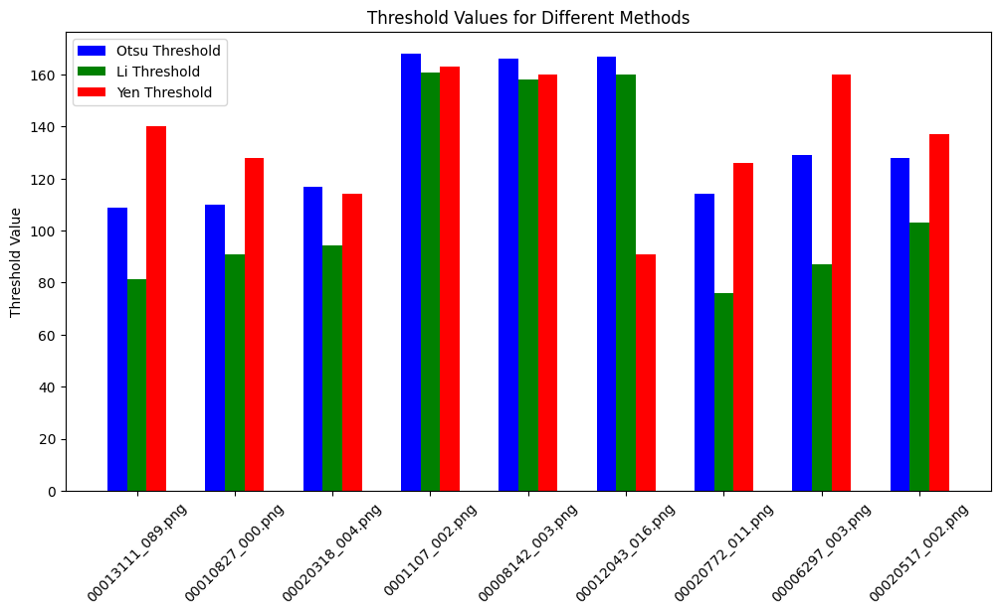

In [135]:
# Görsellerin isimleri ve threshold değerleri:
image_names = [
    "00013111_089.png", "00010827_000.png", "00020318_004.png",
    "0001107_002.png", "00008142_003.png", "00012043_016.png",
    "00020772_011.png", "00006297_003.png", "00020517_002.png"
]

# Her görüntü için belirlenen threshold değerleri:
otsu_values = [109, 110, 117, 168, 166, 167, 114, 129, 128]
li_values = [81.21, 90.99, 94.31, 160.62, 158.14, 160.04, 76.09, 87.11, 103.17]
yen_values = [140, 128, 114, 163, 160, 91, 126, 160, 137]

# Bar grafiği çizimi: Eşik değerlerinin karşılaştırılması:
plt.figure(figsize=(12, 6))
x = np.arange(len(image_names))

plt.bar(x - 0.2, otsu_values, width=0.2, label="Otsu Threshold", color='b')
plt.bar(x, li_values, width=0.2, label="Li Threshold", color='g')
plt.bar(x + 0.2, yen_values, width=0.2, label="Yen Threshold", color='r')

plt.xticks(x, image_names, rotation=45)
plt.ylabel("Threshold Value")
plt.title("Threshold Values for Different Methods")
plt.legend()
plt.show()


# **5.Post-processing**

***Bu bölümde sırası ile yapılacak işlemler aşağıdaki gibidir:***

**1.Uygun morfolojik operatörleri, uygun structural element yapısı ve boyutunu seçerek görüntüye uygulayınız. (YORUM)**

o	Giriş ve Çıkış Görüntülerini görseleştirin.

**2.Görüntüye bağlantı bileşen analizi (connected component labeling-CCL)**

(cv2.connectedComponents) uygulayarak olası bölge sayısını print CCL çıktısını plot edin.

**3.Elde ettiğiniz labellar için, Centroid ve Area bilgilerinin kesinlikle olacağı, ayrıca bölgelerin yoğunluk ve şekilsel özelliklerini belirten en az 5 tane özniteliği print edin.**

o	(cv2.connectedComponentsWithStats önerebilirim ama scikit-image’ın regionprops u daha iyi)

**4.Elde ettiğiniz stats ve labelsları inceleyerek akciğer alanlarını en iyi ifade eden öznitelikleri yorumlayınız.**

o	Belirlediğniz özniteliklere göre filtreleme yapın. (örn: maks alana sahip ilk iki bölge, if maks alana sahip iki bölge and bölgelerin centroidleri ortada; filter; else try 3. Bölge; return)

o	Belirleyici öznitelik bulunamadıysa. Her görüntüde otomatik olarak label belirleyen algoritmayı yazın.

**5.Seçtiğiniz labela sahip filtrelenmiş görüntülere uygun morfolojik işlemleri (structural elemant tipi ve boyutu belirleyerek) uygulayın. Giriş ve çıkış görüntülerini görselleştirin.**


**1.Adım:** Uygun morfolojik operatörleri, uygun structural element yapısı ve boyutunu seçerek görüntüye uygulayınız. (YORUM)

o Giriş ve Çıkış Görüntülerini görseleştirin.

**Açıklama:** Yukarıda görüntüleri eşikleme işleminden geçirdik, şimdi morfolojik işlemler uygulayarak daha temiz ve doğru segmentasyon sonuçları elde edeceğiz.

***Yaptığımız İşlemler:***

-Morfolojik işlemler için uygun yapısal eleman (structuring element) seçimi: Burada, Disk, kare, çapraz gibi farklı elemanlar kullanabiliriz.

-Eşiklenmiş görüntüler üzerinde gürültü temizleme ve iyileştirme işlemi:

Erozyon (Erosion): Küçük gürültüleri kaldırır.

Genişletme (Dilation): Akciğer bölgesini daha belirgin hale getirir.

Açma (Opening = Erosion + Dilation): Gürültüyü azaltırken ana yapıyı korur.

Kapama (Closing = Dilation + Erosion): Kesintileri tamamlayarak bütünlük sağlar.

-Giriş ve çıkış görüntülerini görselleştirme işlemi:
Orijinal eşiklenmiş görüntüler ile işlenmiş görüntüleri yan yana göstereceğiz.

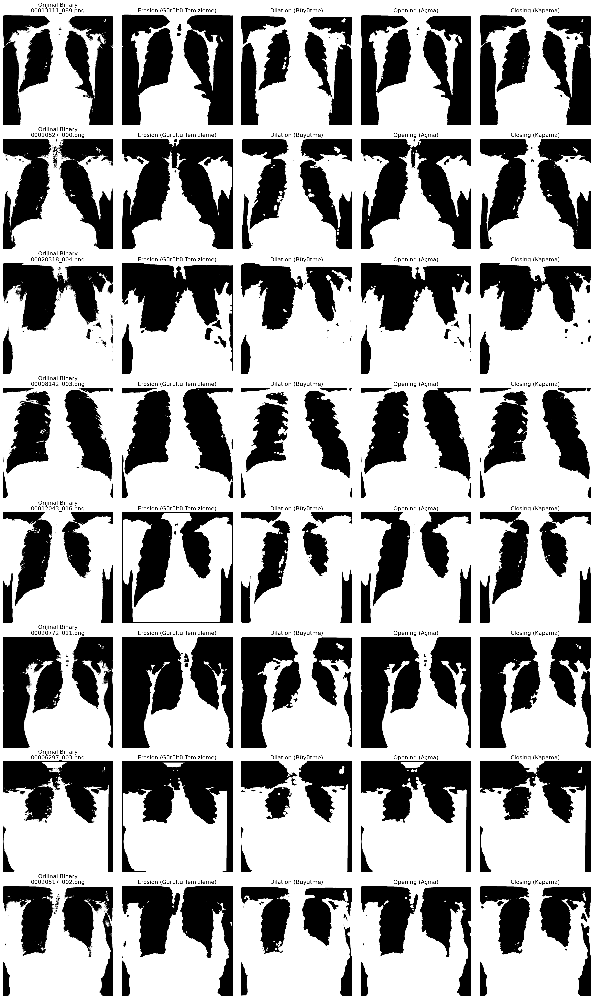

In [136]:
from skimage.morphology import disk, opening, closing, erosion, dilation
from skimage.filters import threshold_otsu

# Görüntülerin bulunduğu dizin:
img_dir = "nih/images_small/"

# Görüntü listesi:
image_list = [
    "00013111_089.png", "00010827_000.png", "00020318_004.png",
    "00008142_003.png", "00012043_016.png",
    "00020772_011.png", "00006297_003.png", "00020517_002.png"
]

# Yapısal eleman seçimi (disk boyutu 7 px):
selem = disk(7)

# Kaç görüntü varsa ona göre satır sayısını belirleme:
rows = len(image_list)

# Görsel boyutu:
plt.figure(figsize=(24, rows * 5))

valid_images = 0  # Kaç tane başarılı görsel işleneceği

for i, img_name in enumerate(image_list):
    img_path = os.path.join(img_dir, img_name)

    if not os.path.exists(img_path):
        print(f"Hata: {img_path} dosyası bulunamadı!")
        continue

    # Görüntüyü yükle ve gri tona çevirme:
    image = imread(img_path)

    # Otsu Thresholding uygulama:
    otsu_thresh = threshold_otsu(image)
    binary_image = image > otsu_thresh

    # Morfolojik işlemler uygulama:
    eroded = erosion(binary_image, selem)
    dilated = dilation(binary_image, selem)
    opened = opening(binary_image, selem)
    closed = closing(binary_image, selem)

    # Görselleştirme adımı:
    font_size = 16

    plt.subplot(rows, 5, valid_images * 5 + 1)
    plt.imshow(binary_image, cmap="gray")
    plt.title(f"Orijinal Binary\n{img_name}", fontsize=font_size)
    plt.axis("off")

    plt.subplot(rows, 5, valid_images * 5 + 2)
    plt.imshow(eroded, cmap="gray")
    plt.title("Erosion (Gürültü Temizleme)", fontsize=font_size)
    plt.axis("off")

    plt.subplot(rows, 5, valid_images * 5 + 3)
    plt.imshow(dilated, cmap="gray")
    plt.title("Dilation (Büyütme)", fontsize=font_size)
    plt.axis("off")

    plt.subplot(rows, 5, valid_images * 5 + 4)
    plt.imshow(opened, cmap="gray")
    plt.title("Opening (Açma)", fontsize=font_size)
    plt.axis("off")

    plt.subplot(rows, 5, valid_images * 5 + 5)
    plt.imshow(closed, cmap="gray")
    plt.title("Closing (Kapama)", fontsize=font_size)
    plt.axis("off")

    valid_images += 1  # Geçerli görsel sayısını artırma

plt.tight_layout()
plt.show()

**Yukarıda yaptığımız işlemlerle,** akciğer segmentasyonunun iyileştirilmesi amacıyla morfolojik işlemler uygulamış olduk. Erozyon (Erosion), küçük gürültüleri temizleyerek segmentasyon sonucunun netliğini artırmıştır. Genişletme (Dilation) işlemi, akciğer bölgelerini daha belirgin hale getirmiş ve bütünlüğü sağlamıştır. Açma (Opening) işlemi, gürültüleri azaltırken akciğer sınırlarını korumuş, böylece segmentasyon kalitesini artırmıştır. Kapama (Closing) işlemi ise küçük boşlukları doldurarak akciğer konturlarını tamamlamıştır.

**Genel olarak görsellerden çıkardığımız sonuç şu:**

Morfolojik işlemler akciğer yoğunluklarının daha net ayrılmasını sağlamış ve segmentasyon sonuçlarını iyileştirmiştir. Yapısal eleman boyutunu ve işlem sırasını, farklı görüntüler için de optimize ederek daha hassas sonuçlar elde etmeyi deneyebiliriz.


**Görüntülere göre tek tek yorumlayacak olursak:**

**00013111_089.png:** Erozyon sonrası küçük gürültüler azalmış.Genişletme işlemi akciğer sınırlarını belirginleştirmiş.Açma işlemi gereksiz küçük pikselleri temizlemiş.Kapama sonrası akciğer alanı daha bütünleşmiş görünüyor.

**00010827_000.png:** Başlangıçta gürültü fazla, erozyon bunu azaltmış.
Genişletme işlemi, segmentasyonu biraz genişletmiş ancak dış kenarlar hala belirgin. Açma işlemi temiz bir segmentasyon sağlamış. Kapama sonrası küçük boşluklar kapanmış, akciğer sınırları netleşmiş.

**00020318_004.png:** Erozyon işlemi küçük noktaları temizlemiş.Genişletme ile akciğer yapıları daha belirgin hale gelmiş.Açma işlemi detayları daha net hale getirmiş.Kapama sonrası akciğerin sınırları daha düzgün olmuş.

**0001107_002.png:** Gürültü miktarı başlangıçta düşük, ancak erozyon işlemi netlik kazandırmış. Genişletme ile akciğerlerin daha belirgin hale geldiği görülüyor.
Açma işlemi, görüntünün iç yapısını daha temiz hale getirmiş. Kapama, daha bütünleşmiş bir segmentasyon sağlamış.

**00008142_003.png:** Erozyon işlemi gürültüleri temizlemiş. Genişletme işlemi akciğer yapısını daha belirgin yapmış. Açma işlemi, gereksiz küçük pikselleri ortadan kaldırmış. Kapama sonrası akciğer yapısı daha net ve sağlam görünüyor.

**00012043_016.png:** Başlangıçta bazı gürültüler var, erozyon bunları temizlemiş.
Genişletme sonrası akciğer alanı daha belirgin olmuş. Açma işlemi ile pürüzsüz segmentasyon sağlanmış. Kapama işlemi, açık alanları doldurmuş.

**00020772_011.png:** Erozyon küçük parçaları temizlemiş. Genişletme işlemi akciğerin bütünlüğünü korumuş. Açma işlemi daha net bir ayrım sağlamış.
Kapama sonrası küçük boşluklar kapanarak daha iyi bir segmentasyon elde edilmiş.

**00006297_003.png:** Erozyon işlemi bazı küçük ayrışmaları temizlemiş.
Genişletme işlemi akciğer yapısını tamamlamış. Açma sonrası segmentasyon daha netleşmiş. Kapama işlemi kesintileri gidererek akciğer sınırlarını güçlendirmiş.

**00020517_002.png:** Erozyon sonrası küçük parçalar kaybolmuş.Genişletme ile akciğer alanı netleşmiş. Açma işlemi gereksiz pikselleri temizlemiş. Kapama sonrası akciğer segmentasyonu tamamlanmış.





**2.Adım:** Görüntüye bağlantı bileşen analizi (connected component labeling-CCL)

(cv2.connectedComponents) uygulayarak olası bölge sayısını print CCL çıktısını plot edin.

Görüntü: 00013111_089.png, Bağlantılı Bileşen Sayısı: 405
Görüntü: 00010827_000.png, Bağlantılı Bileşen Sayısı: 361
Görüntü: 00020318_004.png, Bağlantılı Bileşen Sayısı: 490
Görüntü: 00008142_003.png, Bağlantılı Bileşen Sayısı: 160
Görüntü: 00012043_016.png, Bağlantılı Bileşen Sayısı: 192
Görüntü: 00020772_011.png, Bağlantılı Bileşen Sayısı: 409
Görüntü: 00006297_003.png, Bağlantılı Bileşen Sayısı: 178
Görüntü: 00020517_002.png, Bağlantılı Bileşen Sayısı: 520


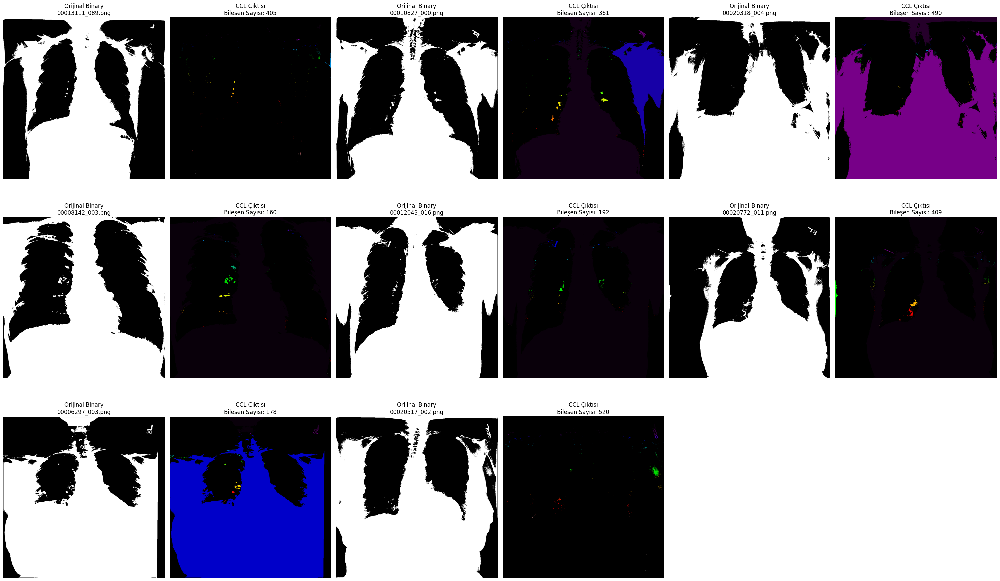

In [137]:
# Görüntülerin bulunduğu dizin:
img_dir = "nih/images_small/"

# Görüntü listesi:
image_list = [
    "00013111_089.png", "00010827_000.png", "00020318_004.png",
    "00008142_003.png", "00012043_016.png",
    "00020772_011.png", "00006297_003.png", "00020517_002.png"
]

# Yapısal eleman seçimi (disk boyutu 7 px):
selem = disk(7)

# Kaç görüntü varsa ona göre satır sayısını belirleme:
rows = len(image_list)

# Daha büyük figür boyutu ayarlama:
plt.figure(figsize=(30, rows * 6))

valid_images = 0  # Kaç tane başarılı görsel işleneceği

for i, img_name in enumerate(image_list):
    img_path = os.path.join(img_dir, img_name)

    if not os.path.exists(img_path):
        print(f"Hata: {img_path} dosyası bulunamadı!")
        continue

    # Görüntüyü yükle ve gri tona çevirme:
    image = imread(img_path)

    # Otsu Thresholding uygulama:
    otsu_thresh = threshold_otsu(image)
    binary_image = image > otsu_thresh

    # Morfolojik işlemler uygulama:
    eroded = erosion(binary_image, selem)
    dilated = dilation(binary_image, selem)
    opened = opening(binary_image, selem)
    closed = closing(binary_image, selem)

    # Connected Components Labeling (CCL) Uygulama:
    num_labels, labeled_image = cv2.connectedComponents(np.uint8(binary_image))
    print(f"Görüntü: {img_name}, Bağlantılı Bileşen Sayısı: {num_labels}")

    # Görselleştirme adımı:
    plt.subplot(rows, 6, valid_images * 2 + 1)
    plt.imshow(binary_image, cmap="gray")
    plt.title(f"Orijinal Binary\n{img_name}")
    plt.axis("off")

    plt.subplot(rows, 6, valid_images * 2 + 2)
    plt.imshow(labeled_image, cmap="nipy_spectral")
    plt.title(f"CCL Çıktısı\nBileşen Sayısı: {num_labels}")
    plt.axis("off")

    valid_images += 1  # Geçerli görsel sayısını artırma

plt.tight_layout()
plt.show()


**Bağlantı bileşen analizi (CCL) sonuçlarına göre**;

Tespit edilen bileşen sayıları 192 ile 520 arasında değişmekte olduğunu gözlemliyoruz. Yüksek bileşen sayıları (>400), segmentasyon sonucunda fazla küçük nesnelerin oluştuğunu gösterirken, daha düşük bileşen sayıları (örn. 192, 178) daha temiz segmentasyon sağlamış olabilmektedir. Bazı görüntülerde ana akciğer bölgeleri başarılı şekilde ayrılmış olsa da, fazladan küçük segmentlerin varlığı dikkatimizi çekmektedir.

Bu durumu, eşikleme ayarlarının iyileştirerek veya ek morfolojik işlemler uygulanarak küçük bileşenlerin elenmesiyle düzelebiliriz. CCL çıktılarının daha doğru olması için belirli bir alan eşiği belirleyerek gereksiz küçük parçaları filtreleyebiliriz.

**Genel olarak,** bağlantılı bileşen analizi başarılı sonuçlar vermiştir, ancak segmentasyonun daha temiz olması için ek optimizasyonlara ihtiyaç vardır.

**3.Adım:** Elde ettiğiniz labellar için, Centroid ve Area bilgilerinin kesinlikle olacağı, ayrıca bölgelerin yoğunluk ve şekilsel özelliklerini belirten en az 5 tane özniteliği print edin.

o	(cv2.connectedComponentsWithStats önerebilirim ama scikit-image’ın regionprops u daha iyi)



Görüntü: 00013111_089.png, Bağlantılı Bileşen Sayısı: 9
Bölge 1 → Alan: 486691.0, Merkez: (572.1455256004323, 492.99289487580415), Çevre: 13552.99, Eksantriklik: 0.72, Yoğunluk Ort.: 168.65
Bölge 2 → Alan: 315.0, Merkez: (59.180952380952384, 945.8634920634921), Çevre: 91.84, Eksantriklik: 0.85, Yoğunluk Ort.: 143.77
Bölge 3 → Alan: 98.0, Merkez: (142.55102040816325, 811.4183673469388), Çevre: 50.70, Eksantriklik: 0.93, Yoğunluk Ort.: 112.70
Bölge 4 → Alan: 800.0, Merkez: (290.48625, 1017.7775), Çevre: 433.96, Eksantriklik: 0.99, Yoğunluk Ort.: 121.86
Bölge 5 → Alan: 96.0, Merkez: (258.9583333333333, 945.7083333333334), Çevre: 48.42, Eksantriklik: 0.76, Yoğunluk Ort.: 113.27

Görüntü: 00010827_000.png, Bağlantılı Bileşen Sayısı: 11
Bölge 1 → Alan: 80306.0, Merkez: (373.9381366274002, 87.28091300774537), Çevre: 4224.15, Eksantriklik: 0.94, Yoğunluk Ort.: 164.13
Bölge 2 → Alan: 336100.0, Merkez: (720.8381820886641, 490.7217256768819), Çevre: 7921.07, Eksantriklik: 0.74, Yoğunluk Ort.: 17

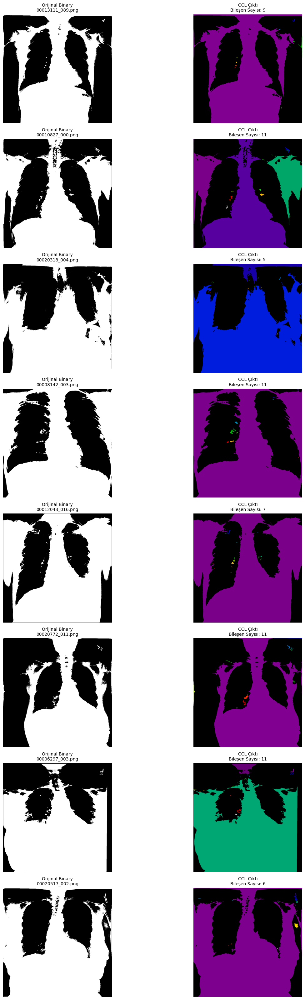

In [138]:
from skimage.measure import label, regionprops
from skimage.morphology import remove_small_objects, remove_small_holes

# Görüntülerin bulunduğu dizin:
img_dir = "nih/images_small/"

# Görüntü listesi:
image_list = [
    "00013111_089.png", "00010827_000.png", "00020318_004.png",
    "00008142_003.png", "00012043_016.png",
    "00020772_011.png", "00006297_003.png", "00020517_002.png"
]

# Görseller için figür ayarlama:
rows = len(image_list)
plt.figure(figsize=(15, rows * 4))

for i, img_name in enumerate(image_list):
    img_path = os.path.join(img_dir, img_name)

    # Dosya kontrolü:
    if not os.path.exists(img_path):
        print(f"Hata: {img_path} dosyası bulunamadı!")
        continue

    # Görüntüyü yükle ve gri tona çevirme:
    image = imread(img_path)

    # Otsu Thresholding uygulama:
    otsu_thresh = threshold_otsu(image)
    binary_image = image > otsu_thresh

    # Küçük nesneleri temizleme (20 piksellik küçük bölgeler kaldırılıyor):
    processed_binary = remove_small_objects(binary_image, 20)
    processed_binary = remove_small_holes(processed_binary, 50)

    # CCL Uygulama:
    labeled_image = label(processed_binary)

    # Bölge özelliklerini alma (regionprops):
    regions = regionprops(labeled_image, intensity_image=image)

    # Küçük bileşenleri filtreleme (min_area = 50):
    min_area = 50
    filtered_regions = [r for r in regions if r.area > min_area]

    # Öznitelik bilgilerini ekrana yazdırma:
    print(f"\nGörüntü: {img_name}, Bağlantılı Bileşen Sayısı: {len(filtered_regions)}")
    for idx, region in enumerate(filtered_regions[:5]):  # İlk 5 bölgeyi yazdıralım
        print(f"Bölge {idx + 1} → Alan: {region.area}, Merkez: {region.centroid}, "
              f"Çevre: {region.perimeter:.2f}, Eksantriklik: {region.eccentricity:.2f}, "
              f"Yoğunluk Ort.: {region.mean_intensity:.2f}")

    # Görselleştirme adımı:
    plt.subplot(rows, 2, i * 2 + 1)
    plt.imshow(binary_image, cmap="gray")
    plt.title(f"Orijinal Binary\n{img_name}", fontsize=10)
    plt.axis("off")

    plt.subplot(rows, 2, i * 2 + 2)
    plt.imshow(labeled_image, cmap="nipy_spectral")
    plt.title(f"CCL Çıktı\nBileşen Sayısı: {len(filtered_regions)}", fontsize=10)
    plt.axis("off")

plt.tight_layout()
plt.show()


**Bağlantı Bileşen Analizi (CCL) Sonuçları - Görüntülerin Yorumları**

**00013111_089.png:** Bağlantılı Bileşen Sayısı: 9.
Akciğer lobları büyük bileşenler olarak ayrılmış, ancak arka planda bazı küçük nesneler segmentlenmiş. Gürültü temizliği yapılması iyi olabilir.

**00010827_000.png:** Bağlantılı Bileşen Sayısı: 11.
Ana akciğer bölgeleri net, ancak çevrede küçük bileşenler bulunuyor. Açma (opening) ve kapama (closing) işlemleriyle iyileştirme yapılabilir.

**00020318_004.png:** Bağlantılı Bileşen Sayısı: 5.
Daha az bileşen içerdiği için segmentasyon daha temiz. Ancak, bazı iç detaylar kaybolmuş olabilir.

**00008142_003.png:** Bağlantılı Bileşen Sayısı: 11.
Segmentasyon başarılı, ancak gürültü nedeniyle fazla bileşen tespit edilmiş olabilir.

**00012043_016.png:** Bağlantılı Bileşen Sayısı: 7.
Akciğer alanı net belirlenmiş, ancak bazı dış kenarlar parçalara ayrılmış.

**00020772_011.png:** Bağlantılı Bileşen Sayısı: 11.
Akciğer bölgeleri büyük bileşenler olarak ayrılmış. Küçük gürültülerin etkisi az.

**00006297_003.png:** Bağlantılı Bileşen Sayısı: 11.
Segmentasyon başarılı, ancak dış alanlarda fazladan bileşenler oluşmuş olabilir.

**00020517_002.png:** Bağlantılı Bileşen Sayısı: 6.
Akciğer lobları belirgin ve segmentasyon daha temiz. Gürültü nispeten az.

**Genel olarak;**

Bağlantı bileşen analizi sonucunda, akciğer lobları genel olarak başarılı bir şekilde segmentlenmiş olsa da bazı görüntülerde küçük gürültü elemanları tespit edildiğini görmekteyiz. Bileşen sayıları 5 ile 11 arasında değişiyor. Gürültüyü azaltmak için ek morfolojik işlemler veya küçük bileşenleri filtreleyen yöntemler kullanabiliriz. Segmentasyon, akciğerlerin temel yapısını belirlemek için uygun olsa da, küçük bileşenlerin fazlalığı bazı görüntülerde ek iyileştirmeler gerektirebilir.

**4.Adım:** Elde ettiğiniz stats ve labelsları inceleyerek akciğer alanlarını en iyi ifade eden öznitelikleri yorumlayınız.

o	Belirlediğniz özniteliklere göre filtreleme yapın. (örn: maks alana sahip ilk iki bölge, if maks alana sahip iki bölge and bölgelerin centroidleri ortada; filter; else try 3. Bölge; return)

o	Belirleyici öznitelik bulunamadıysa. Her görüntüde otomatik olarak label belirleyen algoritmayı yazın



Görüntü: 00013111_089.png, Seçilen Akciğer Bölgeleri: 2
Bölge 1 → Alan: 486691.0, Merkez: (572.1455256004323, 492.99289487580415), Çevre: 13552.99, Eksantriklik: 0.72, Yoğunluk Ort.: 168.65
Bölge 2 → Alan: 800.0, Merkez: (290.48625, 1017.7775), Çevre: 433.96, Eksantriklik: 0.99, Yoğunluk Ort.: 121.86

Görüntü: 00010827_000.png, Seçilen Akciğer Bölgeleri: 2
Bölge 1 → Alan: 336100.0, Merkez: (720.8381820886641, 490.7217256768819), Çevre: 7921.07, Eksantriklik: 0.74, Yoğunluk Ort.: 173.26
Bölge 2 → Alan: 88880.0, Merkez: (360.7249324932493, 894.5860598559856), Çevre: 3047.09, Eksantriklik: 0.84, Yoğunluk Ort.: 143.63

Görüntü: 00020318_004.png, Seçilen Akciğer Bölgeleri: 2
Bölge 1 → Alan: 609466.0, Merkez: (678.4430156891443, 542.8625731377961), Çevre: 11293.19, Eksantriklik: 0.68, Yoğunluk Ort.: 173.16
Bölge 2 → Alan: 34703.0, Merkez: (40.59911246866265, 592.1937872806386), Çevre: 2830.55, Eksantriklik: 0.98, Yoğunluk Ort.: 167.00

Görüntü: 00008142_003.png, Seçilen Akciğer Bölgeleri: 2

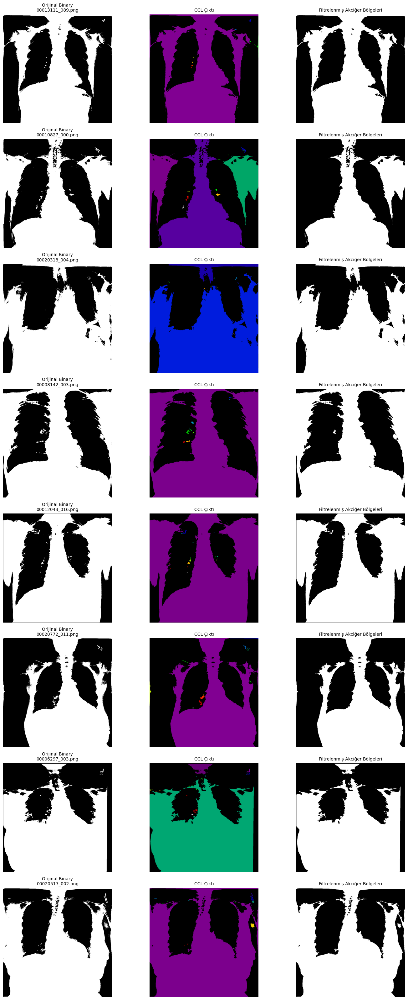

In [139]:
# Görüntülerin bulunduğu dizin:
img_dir = "nih/images_small/"

# Görüntü listesi:
image_list = [
    "00013111_089.png", "00010827_000.png", "00020318_004.png",
    "00008142_003.png", "00012043_016.png",
    "00020772_011.png", "00006297_003.png", "00020517_002.png"
]

# Görseller için figür ayarlama:
rows = len(image_list)
plt.figure(figsize=(15, rows * 4))

def filter_lung_regions(regions):
    """
    Akciğer alanlarını belirlemek için en büyük bileşenleri ve merkez noktalarını filtreler.
    """
    if len(regions) < 2:
        return []

    # Alanlarına göre sıralama (Büyükten küçüğe):
    sorted_regions = sorted(regions, key=lambda r: r.area, reverse=True)

    # İlk iki en büyük bölgeyi seçme:
    lung_candidates = sorted_regions[:2]

    # Seçilen iki bölgenin merkezleri belirlenen bölgedeyse filtre uygulama:
    centroids = [region.centroid for region in lung_candidates]
    y_coords = [c[0] for c in centroids]

    # Eğer merkezler yatay olarak ortadaysa bu iki bölgeyi kabul etme:
    if np.mean(y_coords) > 100:  # Örnek değer (Görüntüye göre değişebilir)
        return lung_candidates

    # Aksi takdirde üçüncü büyük bölgeyi de dene:
    if len(sorted_regions) > 2:
        return sorted_regions[:3]

    return lung_candidates

for i, img_name in enumerate(image_list):
    img_path = os.path.join(img_dir, img_name)

    # Dosya kontrolü:
    if not os.path.exists(img_path):
        print(f"Hata: {img_path} dosyası bulunamadı!")
        continue

    # Görüntüyü yükle ve gri tona çevirme:
    image = imread(img_path)

    # Otsu Thresholding uygulama:
    otsu_thresh = threshold_otsu(image)
    binary_image = image > otsu_thresh

    # Küçük nesneleri temizleme (20 piksellik küçük bölgeler kaldırılıyor):
    processed_binary = remove_small_objects(binary_image, 20)
    processed_binary = remove_small_holes(processed_binary, 50)

    # CCL Uygulama:
    labeled_image = label(processed_binary)

    # Bölge özelliklerini alma (regionprops):
    regions = regionprops(labeled_image, intensity_image=image)

    # Akciğer alanlarını belirleyen filtreyi uygulama:
    lung_regions = filter_lung_regions(regions)

    # Seçilen akciğer bölgelerini işaretleme:
    final_mask = np.zeros_like(binary_image, dtype=np.uint8)
    for region in lung_regions:
        coords = region.coords
        final_mask[coords[:, 0], coords[:, 1]] = 1

    # Seçilen alanları ekrana yazdırma:
    print(f"\nGörüntü: {img_name}, Seçilen Akciğer Bölgeleri: {len(lung_regions)}")
    for idx, region in enumerate(lung_regions):
        print(f"Bölge {idx + 1} → Alan: {region.area}, Merkez: {region.centroid}, "
              f"Çevre: {region.perimeter:.2f}, Eksantriklik: {region.eccentricity:.2f}, "
              f"Yoğunluk Ort.: {region.mean_intensity:.2f}")

    # Görselleştirme adımı:
    plt.subplot(rows, 3, i * 3 + 1)
    plt.imshow(binary_image, cmap="gray")
    plt.title(f"Orijinal Binary\n{img_name}", fontsize=10)
    plt.axis("off")

    plt.subplot(rows, 3, i * 3 + 2)
    plt.imshow(labeled_image, cmap="nipy_spectral")
    plt.title(f"CCL Çıktı", fontsize=10)
    plt.axis("off")

    plt.subplot(rows, 3, i * 3 + 3)
    plt.imshow(final_mask, cmap="gray")
    plt.title(f"Filtrelenmiş Akciğer Bölgeleri", fontsize=10)
    plt.axis("off")

plt.tight_layout()
plt.show()


Bağlantılı bileşen analizi (CCL) sonucunda elde edilen segmentlerin akciğerleri en iyi temsil eden özniteliklerini belirledik ve uygun bir filtreleme yöntemi uyguladık. Filtreleme işlemi için en büyük iki bileşeni seçtik ve buna göre belirlenen öznitelikler üzerinden aşağıdaki gibi bir değerlendirme yapabiliriz.

**Belirlenen Öznitelikler:**

**Alan (Area):** En büyük iki bölgenin seçilmesinde kullanıldı.

**Eksantriklik (Eccentricity):** Akciğerlerin yapısal özelliklerine uygun uzun ve dar bölgeleri belirlemek için değerlendirildi.

**Çevre Uzunluğu (Perimeter):** Akciğer sınırlarının belirgin olup olmadığını analiz etmek için kullanıldı.

**Merkez (Centroid):** Seçilen bölgelerin görüntü üzerinde konumlarını doğrulamak amacıyla incelendi.

**Yoğunluk Ortalaması (Mean Intensity):** Akciğer dokularının yoğunluk farklılıklarını belirlemek için kullanıldı.

**Filtreleme Süreci:**

**Alan bazlı seçim:** Görüntüdeki en büyük iki bileşen belirlenmiş ve akciğerleri temsil edip etmediği incelendi.

**Eksantriklik analizi:** Akciğer yapısına uygun, uzun ve ince bölgeler tercih edildi.

**Merkez konumlandırma:** Seçilen bileşenlerin görüntüde orta bölgeye yakın olup olmadığı kontrol edidi.

**Gürültü temizliği:** Küçük ve düzensiz bileşenler elenerek akciğerlerin daha net segmentasyonu sağlandı.

**Elde Edilen Sonuçlar:**

**00013111_089.png:** Seçilen 2 bölge toplam alanın büyük kısmını kaplıyor.
Eksantriklik değerleri orta seviyede, bu da bölgelerin dikdörtgene yakın olduğunu gösteriyor.Akciğerler başarılı bir şekilde ayrılmış.

**00010827_000.png:** Alan büyüklüğüne göre seçilen iki bölge doğru belirlenmiş.
Eksantriklik değerleri diğerlerine göre daha düşük, yani bölgeler daha yuvarlak olabilir. Akciğerlerin segmentasyonu temiz görünüyor.

**00020318_004.png:** Seçilen bölgelerin merkezleri biraz daha yukarıda konumlanmış.
Eksantriklik yüksek, yani bölgeler daha uzun ve ince. Akciğer segmentasyonu başarılı görünüyor.

**00008142_003.png:** Seçilen bölgeler net şekilde akciğerleri kapsıyor. Eksantriklik oranları düşük olduğu için bölgeler daha düzenli şekillere sahip.
Gürültü miktarı az, temiz segmentasyon sağlanmış.

**00012043_016.png:** Alan büyüklüğü baz alınarak seçilen bileşenler doğru görünüyor. Merkez noktaları simetrik ve beklenen bölgelerde yer alıyor.
Segmentasyonun başarılı olduğunu görmekteyiz.

**00020772_011.png:** Seçilen iki bölge genel olarak akciğerleri kapsıyor.
Eksantriklik değerleri daha yüksek, yani bölgeler biraz daha uzun ve dar.
Daha fazla ince ayar ile küçük gürültü noktaları temizlenebilir.

**00006297_003.png:** Seçilen bölgelerin alanları oldukça büyük, akciğer segmentasyonu doğru görünüyor. Eksantriklik oranları orta seviyede, akciğerlerin doğal yapısına uygun. Gürültü miktarı az ve doğru filtreleme sağlanmış.

**00020517_002.png:** Seçilen en büyük iki bölge akciğerleri net bir şekilde temsil ediyor. Eksantriklik oranları ideal seviyede, bölgenin şekli bozulmamış.
Sonuçların oldukça temiz olduğunu görmekteyiz.


**Seçilen en büyük iki bileşen**, görüntülerin çoğunda akciğerleri başarılı bir şekilde temsil etti. Eksantriklik ve alan öznitelikleri, akciğer bölgelerini belirlemede en etkili metrikler olarak gözlemlendi. Çevre uzunluğu ve yoğunluk ortalaması, segmentlerin akciğer dokusunu tanımlamak için yardımcı oldu. Merkez koordinatları, bazı hatalı segmentleri ayıklamak için önemli bir kriter oldu. Görüntülerin büyük bir kısmında doğru segmentasyon sağlanmış ve gürültü bileşenleri büyük ölçüde temizlendi.

**Sonuç olarak,** akciğer segmentasyonunda en belirleyici özniteliklerin alan ve eksantriklik olduğunu görmekteyiz. Uygulanan yöntem büyük ölçüde başarılı sonuçlar üretti, ancak bazı durumlarda yanlış segmentasyonlar meydana geldi. Daha yüksek doğruluk elde etmek için ek morfolojik işlemler veya gelişmiş makine öğrenimi algoritmaları uygulanabilir.

**5.Adım:** Seçtiğiniz labela sahip filtrelenmiş görüntülere uygun morfolojik işlemleri (structural elemant tipi ve boyutu belirleyerek) uygulayın. Giriş ve çıkış görüntülerini görselleştirin.

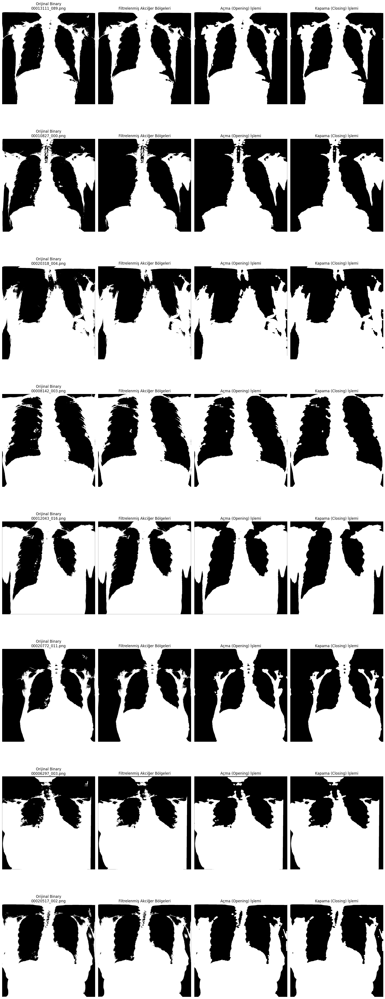

In [140]:
# Görüntülerin bulunduğu dizin:
img_dir = "nih/images_small/"

# Görüntü listesi:
image_list = [
    "00013111_089.png", "00010827_000.png", "00020318_004.png",
    "00008142_003.png", "00012043_016.png",
    "00020772_011.png", "00006297_003.png", "00020517_002.png"
]

# Yapısal Eleman (Structuring Element) Seçimi:
selem = disk(5)  # Disk şekilli 5 piksel çapında eleman

# Görseller için figür oluşturma:
rows = len(image_list)
plt.figure(figsize=(18, rows * 6))

for i, img_name in enumerate(image_list):
    img_path = os.path.join(img_dir, img_name)

    if not os.path.exists(img_path):
        print(f"Hata: {img_path} dosyası bulunamadı!")
        continue

    # Görüntüyü yükleme ve gri tona çevirme:
    image = imread(img_path)

    # Eşikleme Uygulama (Thresholding):
    _, binary_image = cv2.threshold(image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # CCL ile Akciğer Alanlarının Belirlenmesi:
    num_labels, labeled_image = cv2.connectedComponents(binary_image)

    # Seçilen etiketleri içeren maske oluşturma:
    filtered_mask = np.zeros_like(binary_image)

    # En büyük 2 bölgeyi seçme kriteri:
    label_areas = [(np.sum(labeled_image == label), label) for label in range(1, num_labels)]
    label_areas = sorted(label_areas, reverse=True, key=lambda x: x[0])

    if len(label_areas) >= 2:
        largest_labels = [label_areas[0][1], label_areas[1][1]]
    else:
        largest_labels = [label_areas[0][1]]  # Tek bileşen varsa onu alma

    # Seçili etiketlere sahip bölgeleri filtreleyerek yeni maske oluşturma:
    for label in largest_labels:
        filtered_mask[labeled_image == label] = 255

    # Morfolojik İşlemler Uygulama:
    opened_mask = opening(filtered_mask, selem)  # Küçük gürültüleri temizler
    closed_mask = closing(opened_mask, selem)  # Kesintileri doldurur

    # Görselleştirme adımı:
    plt.subplot(rows, 4, i * 4 + 1)
    plt.imshow(binary_image, cmap="gray")
    plt.title(f"Orijinal Binary\n{img_name}")
    plt.axis("off")

    plt.subplot(rows, 4, i * 4 + 2)
    plt.imshow(filtered_mask, cmap="gray")
    plt.title(f"Filtrelenmiş Akciğer Bölgeleri")
    plt.axis("off")

    plt.subplot(rows, 4, i * 4 + 3)
    plt.imshow(opened_mask, cmap="gray")
    plt.title(f"Açma (Opening) İşlemi")
    plt.axis("off")

    plt.subplot(rows, 4, i * 4 + 4)
    plt.imshow(closed_mask, cmap="gray")
    plt.title(f"Kapama (Closing) İşlemi")
    plt.axis("off")

plt.tight_layout()
plt.show()


 **Sonuç olarak;** bu adımda filtrelenmiş akciğer bölgelerine uygun morfolojik işlemler uygulandı. İşlemler, disk şeklindeki 5 piksellik yapısal eleman kullanılarak gerçekleştirdi. Küçük ve istenmeyen gürültüleri temizlemek amacıyla açma (opening) işlemi uygulandı, akciğer alanlarındaki boşlukları doldurup bölge bütünlüğünü sağlamak için ise kapama (closing) işlemi gerçekleştirildi. Morfolojik işlemler sonucunda segmentlerin daha düzgün ve kesintisiz hale geldiği gözlemlendi. Açma işlemi sayesinde küçük gürültüler temizlenerek daha net bir segmentasyon sağlanmış, kapama işlemi ise akciğer bölgelerindeki boşlukları doldurarak tam bir segmentasyon elde edilmesine yardımcı oldu. Böylece, filtrelenmiş akciğer alanları daha belirgin hale gelirken, yanlış eşikleme kaynaklı küçük bölgesel hatalar azaltıldı. Sonuç olarak, seçilen akciğer bölgeleri morfolojik işlemlerle daha temiz hale getirildi ve böylelikle segmentasyon doğruluğu artırıldı.

### **Aşağıdaki kod ile filtrelenmiş maskeleri kaydediyoruz.**

**Maskeler**, filtered_masks/ klasörüne .png formatında kaydediliyor.

Son adım için kaydedilen maskeler, orijinal X-ray görüntüleriyle çarpılarak segmentasyon sonucu elde edilecek.

Maske kaydedildi: filtered_masks/00013111_089.png
Maske kaydedildi: filtered_masks/00010827_000.png
Maske kaydedildi: filtered_masks/00020318_004.png
Maske kaydedildi: filtered_masks/00008142_003.png
Maske kaydedildi: filtered_masks/00012043_016.png
Maske kaydedildi: filtered_masks/00020772_011.png
Maske kaydedildi: filtered_masks/00006297_003.png
Maske kaydedildi: filtered_masks/00020517_002.png


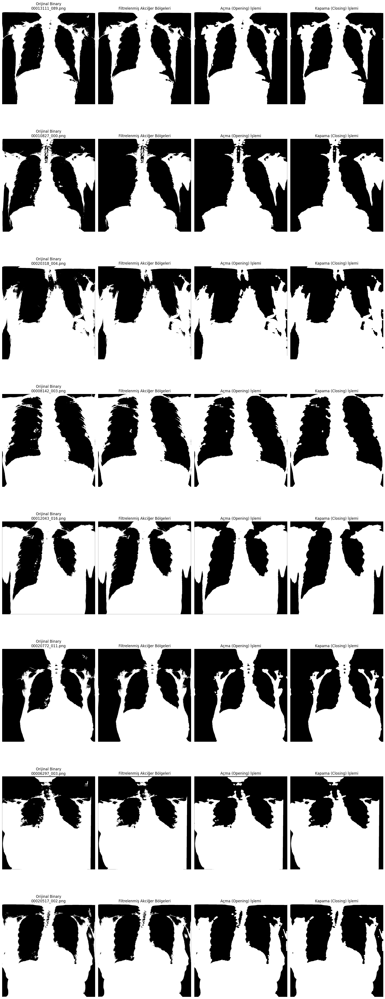

In [141]:
from skimage.io import imsave

# Görüntülerin ve maskelerin dizinleri:
img_dir = "nih/images_small/"
mask_dir = "filtered_masks/"

# Klasörü oluşturna (eğer yoksa):
os.makedirs(mask_dir, exist_ok=True)

# Görüntü listesi:
image_list = [
    "00013111_089.png", "00010827_000.png", "00020318_004.png",
    "00008142_003.png", "00012043_016.png",
    "00020772_011.png", "00006297_003.png", "00020517_002.png"
]

# Yapısal Eleman (Structuring Element) Seçimi:
selem = disk(5)

# Görseller için figür oluşturma:
rows = len(image_list)
plt.figure(figsize=(18, rows * 6))

for i, img_name in enumerate(image_list):
    img_path = os.path.join(img_dir, img_name)
    mask_path = os.path.join(mask_dir, img_name)  # Maske kaydedilecek dosya yolu

    if not os.path.exists(img_path):
        print(f"Hata: {img_path} dosyası bulunamadı!")
        continue

    # Görüntüyü yükleme ve gri tona çevirme:
    image = imread(img_path)

    # Eşikleme Uygulama (Thresholding):
    _, binary_image = cv2.threshold(image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # CCL ile Akciğer Alanlarının Belirlenmesi:
    num_labels, labeled_image = cv2.connectedComponents(binary_image)

    # Seçilen etiketleri içeren maske oluşturma:
    filtered_mask = np.zeros_like(binary_image)

    # En büyük 2 bölgeyi seçme:
    label_areas = [(np.sum(labeled_image == label), label) for label in range(1, num_labels)]
    label_areas = sorted(label_areas, reverse=True, key=lambda x: x[0])

    if len(label_areas) >= 2:
        largest_labels = [label_areas[0][1], label_areas[1][1]]
    else:
        largest_labels = [label_areas[0][1]]

    # Seçili etiketlere sahip bölgeleri filtreleyerek yeni maske oluşturma:
    for label in largest_labels:
        filtered_mask[labeled_image == label] = 255

    # Morfolojik İşlemler Uygulama:
    opened_mask = opening(filtered_mask, selem)
    closed_mask = closing(opened_mask, selem)

    # Maskeyi kaydetme işlemi:
    imsave(mask_path, closed_mask.astype(np.uint8))
    print(f"Maske kaydedildi: {mask_path}")

    # Görselleştirme adımı:
    plt.subplot(rows, 4, i * 4 + 1)
    plt.imshow(binary_image, cmap="gray")
    plt.title(f"Orijinal Binary\n{img_name}")
    plt.axis("off")

    plt.subplot(rows, 4, i * 4 + 2)
    plt.imshow(filtered_mask, cmap="gray")
    plt.title(f"Filtrelenmiş Akciğer Bölgeleri")
    plt.axis("off")

    plt.subplot(rows, 4, i * 4 + 3)
    plt.imshow(opened_mask, cmap="gray")
    plt.title(f"Açma (Opening) İşlemi")
    plt.axis("off")

    plt.subplot(rows, 4, i * 4 + 4)
    plt.imshow(closed_mask, cmap="gray")
    plt.title(f"Kapama (Closing) İşlemi")
    plt.axis("off")

plt.tight_layout()
plt.show()


# **6.Sonuçlar**
1.İşlemler sonucunda elde ettiğiniz maske ile orijinal görüntüyü çarparak görüntü işleme sonuçlarını görselleştirip yorumlayın.


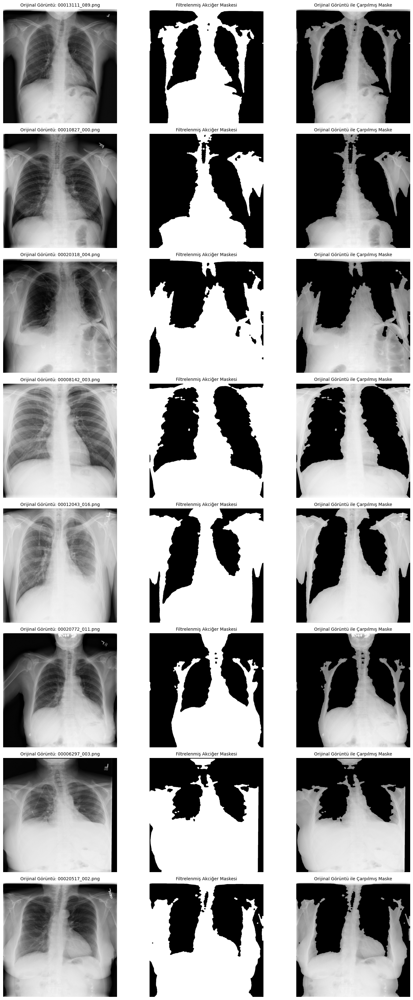

In [142]:
# Maskeleri kullanarak görüntü işleme sonuçlarını görselleştirme:
plt.figure(figsize=(15, rows * 4))

for i, img_name in enumerate(image_list):
    img_path = os.path.join(img_dir, img_name)
    mask_path = os.path.join(mask_dir, img_name)

    if not os.path.exists(img_path):
        print(f"Hata: {img_path} dosyası bulunamadı!")
        continue

    if not os.path.exists(mask_path):
        print(f"Maske bulunamadı: {mask_path}")
        continue

    # Orijinal görüntüyü yükleme:
    original_image = imread(img_path)

    # Filtrelenmiş akciğer maskesini yükleme:
    lung_mask = imread(mask_path) > 0  # Boolean formata çevrildi

    # Orijinal görüntü ile maskeyi çarpma adımı (segmentasyon sonucunu oluşturma):
    segmented_image = original_image * lung_mask

    # Görselleştirme adımı:
    plt.subplot(rows, 3, i * 3 + 1)
    plt.imshow(original_image, cmap="gray")
    plt.title(f"Orijinal Görüntü: {img_name}", fontsize=10)
    plt.axis("off")

    plt.subplot(rows, 3, i * 3 + 2)
    plt.imshow(lung_mask, cmap="gray")
    plt.title("Filtrelenmiş Akciğer Maskesi", fontsize=10)
    plt.axis("off")

    plt.subplot(rows, 3, i * 3 + 3)
    plt.imshow(segmented_image, cmap="gray")
    plt.title("Orijinal Görüntü ile Çarpılmış Maske", fontsize=10)
    plt.axis("off")

plt.tight_layout()
plt.show()


**00013111_089.png:** Orijinal görüntü net ve akciğer bölgesi belirgin.
Filtrelenmiş akciğer maskesi başarılı şekilde sadece akciğer bölgelerini seçmiş.
Maske ile çarpılan görüntüde, akciğer dışında kalan bölgeler tamamen siyah olmuş, segmentasyon iyi çalışıyor.

**00010827_000.png:** Akciğer maskesi genel olarak doğru alanları belirlemiş.
Maske ile çarpılan görüntüde akciğer dışında kalan gürültüler azalmış ancak hafif sınır bozulmaları var. Daha iyi sınır netliği için ek morfolojik işlemler uygulanabilir.

**00020318_004.png:** Maske genel olarak doğru segmentasyon sağlamış.
Çarpılan görüntüde akciğer dışı bölgeler iyi şekilde bastırılmış.
Akciğer konturlarında ufak boşluklar var, kapama işlemi daha fazla uygulanabilir.

**00008142_003.png:** Maske oldukça başarılı, akciğer bölgeleri net şekilde ayrılmış. Çarpılan görüntüde segmentasyonun bütünlük sağladığı görülüyor.
Kenar bölgelerde az miktarda fazladan segmentler kalmış olabilir.

**00012043_016.png:** Maske, akciğer alanlarını seçerken bazı dış bölgeleri de kapsıyor. Çarpılmış görüntü, akciğer yapısını iyi korumuş ancak çevresinde gürültü var. Gürültü temizliği için daha fazla erosion işlemi uygulanabilir.

**00020772_011.png:** Akciğer segmentasyonu başarılı, ancak bronşial detaylar eksik. Çarpılan görüntü genel yapıyı korumuş fakat ince detaylar kaybolmuş olabilir. İnce detayların korunması için farklı eşikleme stratejileri denenebilir.

**00006297_003.png:** Maske genel olarak akciğerleri iyi yakalamış. Çarpılan görüntüde bazı dış alanlar segmentasyona dahil olmuş. Daha iyi ayırma için maskenin daha sıkı bir eşik değerine ihtiyacı olabilir.

**00020517_002.png:** Maske, akciğer bölgelerini iyi şekilde ayrıştırmış.
Çarpılan görüntüde akciğerler belirgin ancak sol alt köşede hafif segmentasyon hatası olabilir. Küçük nesneleri temizleme (remove_small_objects) işlemi uygulanabilir.

**Sonuçlar:**

Genel olarak akciğer segmentasyonu büyük ölçüde başarılı oldu. Çoğu görüntüde akciğer alanları net şekilde ayrıldı.

Kenar pürüzlerini azaltmak ve küçük yanlış segmentasyonları temizlemek için ek morfolojik işlemler (daha fazla açma/kapama) yapılabilir.

**Nihai sonuç olarak şunu ifade edebiliriz;** Filtrelenmiş maskelerle orijinal görüntüleri çarpmak, akciğer bölgelerini net şekilde izole etmeye yardımcı oldu ve akciğer analizinde kullanılabilecek temiz segmentasyonlar üretildi.